# Importing Libraries

In [239]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn import preprocessing 

from sklearn.preprocessing import LabelEncoder
%matplotlib inline
from sklearn.neighbors import KNeighborsClassifier
from sklearn import datasets, linear_model, metrics
from sklearn.metrics import  confusion_matrix
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report,confusion_matrix

# Loading DataSet

In [4]:
df = pd.read_csv('Stars.csv')
df

,Temperature,L,R,A_M,Color,Spectral_Class,Type
0,3068,0.002400,0.1700,16.12,Red,M,0
1,3042,0.000500,0.1542,16.60,Red,M,0
2,2600,0.000300,0.1020,18.70,Red,M,0
3,2800,0.000200,0.1600,16.65,Red,M,0
4,1939,0.000138,0.1030,20.06,Red,M,0
...,...,...,...,...,...,...,...
235,38940,374830.000000,1356.0000,-9.93,Blue,O,5
236,30839,834042.000000,1194.0000,-10.63,Blue,O,5
237,8829,537493.000000,1423.0000,-10.73,White,A,5
238,9235,404940.000000,1112.0000,-11.23,White,A,5


# Exploratory Data Analysis

In [5]:
df.head()

,Temperature,L,R,A_M,Color,Spectral_Class,Type
0,3068,0.002400,0.1700,16.12,Red,M,0
1,3042,0.000500,0.1542,16.60,Red,M,0
2,2600,0.000300,0.1020,18.70,Red,M,0
3,2800,0.000200,0.1600,16.65,Red,M,0
4,1939,0.000138,0.1030,20.06,Red,M,0


In [6]:
df.tail()

,Temperature,L,R,A_M,Color,Spectral_Class,Type
235,38940,374830.0,1356.0,-9.93,Blue,O,5
236,30839,834042.0,1194.0,-10.63,Blue,O,5
237,8829,537493.0,1423.0,-10.73,White,A,5
238,9235,404940.0,1112.0,-11.23,White,A,5
239,37882,294903.0,1783.0,-7.80,Blue,O,5


In [7]:
df.dtypes

Temperature         int64
L                 float64
R                 float64
A_M               float64
Color              object
Spectral_Class     object
Type                int64
dtype: object

In [8]:
df.columns

Index(['Temperature', 'L', 'R', 'A_M', 'Color', 'Spectral_Class', 'Type'], dtype='object')

In [9]:
df.shape

(240, 7)

In [10]:
df.size

1680

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 240 entries, 0 to 239
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Temperature     240 non-null    int64  
 1   L               240 non-null    float64
 2   R               240 non-null    float64
 3   A_M             240 non-null    float64
 4   Color           240 non-null    object 
 5   Spectral_Class  240 non-null    object 
 6   Type            240 non-null    int64  
dtypes: float64(3), int64(2), object(2)
memory usage: 13.2+ KB


In [12]:
df.describe()

,Temperature,L,R,A_M,Type
count,240.000000,240.000000,240.000000,240.000000,240.000000
mean,10497.462500,107188.361635,237.157781,4.382396,2.500000
std,9552.425037,179432.244940,517.155763,10.532512,1.711394
min,1939.000000,0.000080,0.008400,-11.920000,0.000000
25%,3344.250000,0.000865,0.102750,-6.232500,1.000000
50%,5776.000000,0.070500,0.762500,8.313000,2.500000
75%,15055.500000,198050.000000,42.750000,13.697500,4.000000
max,40000.000000,849420.000000,1948.500000,20.060000,5.000000


In [13]:
df.isnull().sum()

Temperature       0
L                 0
R                 0
A_M               0
Color             0
Spectral_Class    0
Type              0
dtype: int64

In [14]:
df.duplicated().sum()

0

In [15]:
df.skew()

<ipython-input-15-9e0b1e29546f>:1: FutureWarning: The default value of numeric_only in DataFrame.skew is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.skew()


Temperature    1.321568
L              2.068069
R              1.946800
A_M           -0.121540
Type           0.000000
dtype: float64

In [16]:
df.corr()

<ipython-input-16-2f6f6606aa2c>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,Temperature,L,R,A_M,Type
Temperature,1.000000,0.393404,0.064216,-0.420261,0.411129
L,0.393404,1.000000,0.526516,-0.692619,0.676845
R,0.064216,0.526516,1.000000,-0.608728,0.660975
A_M,-0.420261,-0.692619,-0.608728,1.000000,-0.955276
Type,0.411129,0.676845,0.660975,-0.955276,1.000000


<ipython-input-17-c6d9c2c24b2a>:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  ax = sns.heatmap(df.corr(),annot = True,cmap = 'viridis')


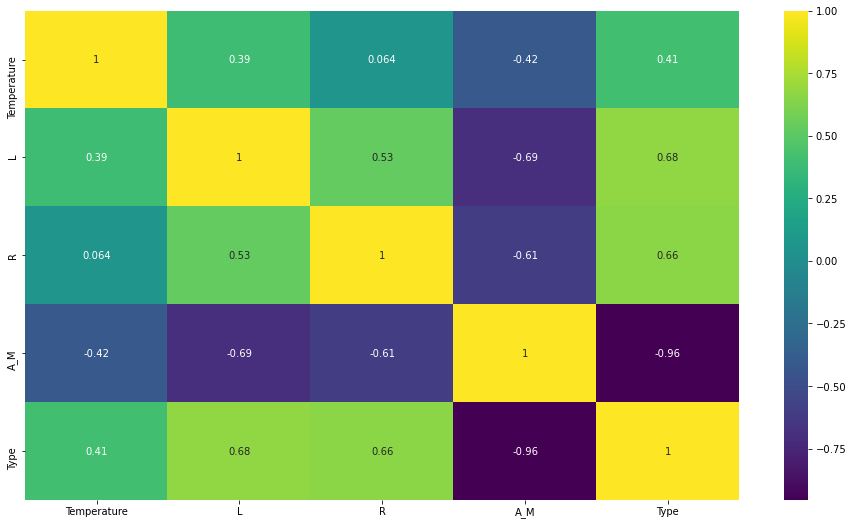

In [17]:
plt.figure(figsize=(16,9))
x = df.drop(['Color','Spectral_Class'],axis = 1)
ax = sns.heatmap(df.corr(),annot = True,cmap = 'viridis')
plt.show()

# Data Visualisation Using Autoviz

In [18]:
! pip install Autoviz

In [19]:
! pip install xlrd

Alert! from autoviz version 0.1.35, after importing, you must %matplotlib inline to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
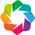

Shape of your Data Set loaded: (240, 7)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    7 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
Number of All Scatter Plots = 6
Time to run AutoViz = 4 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


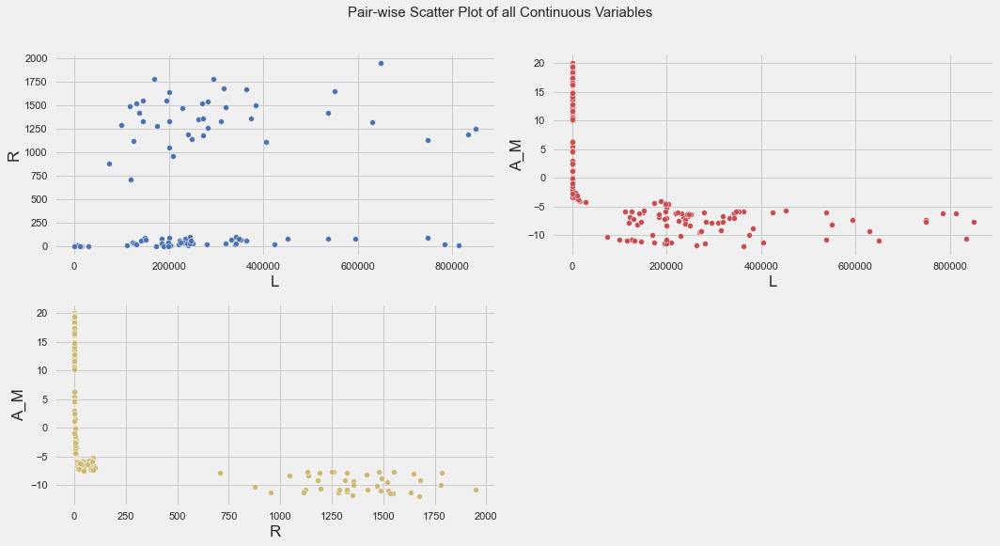

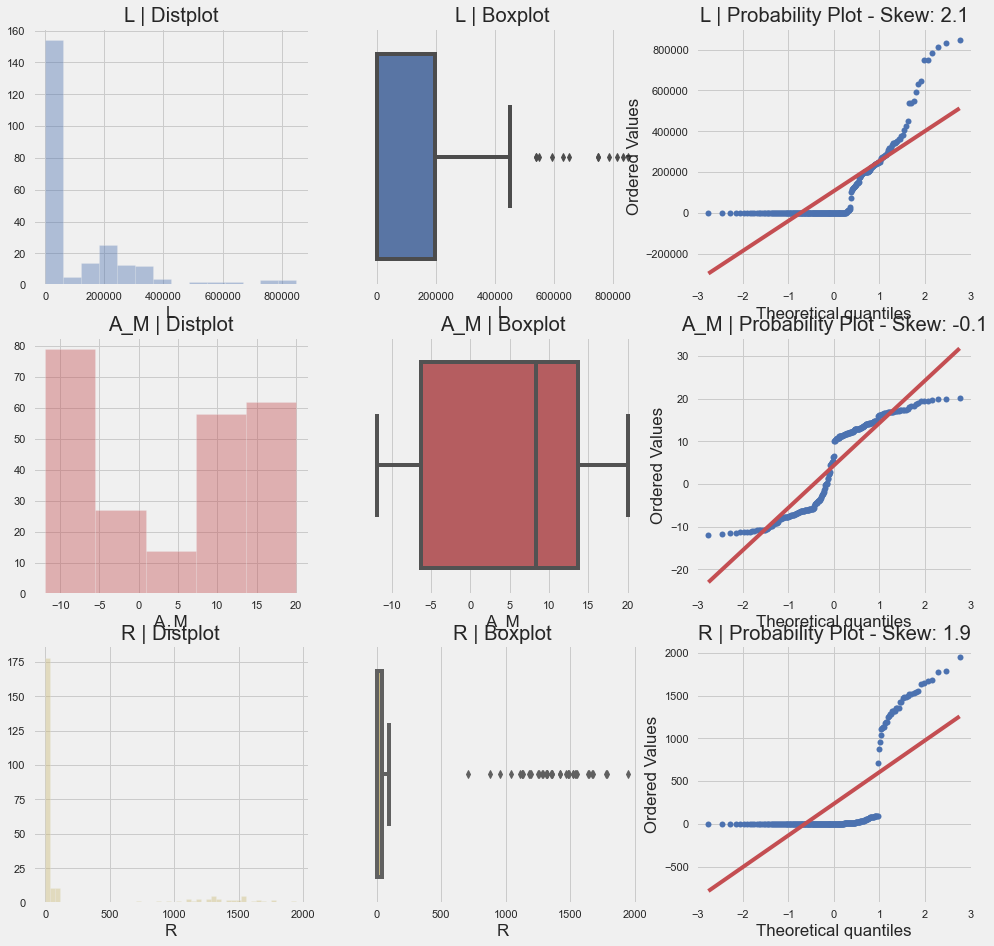

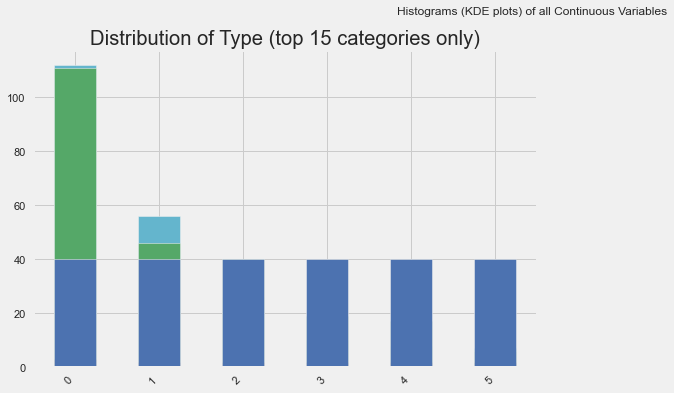

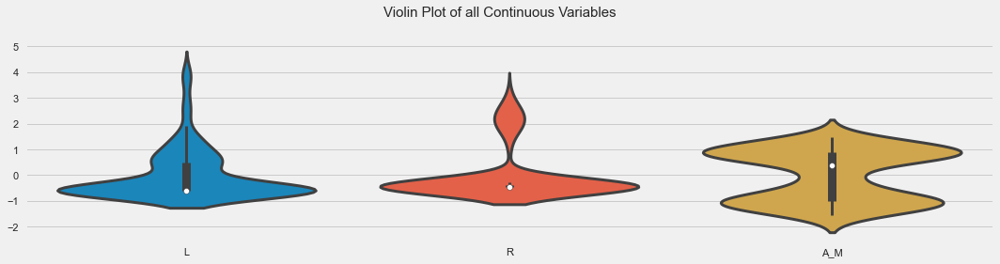

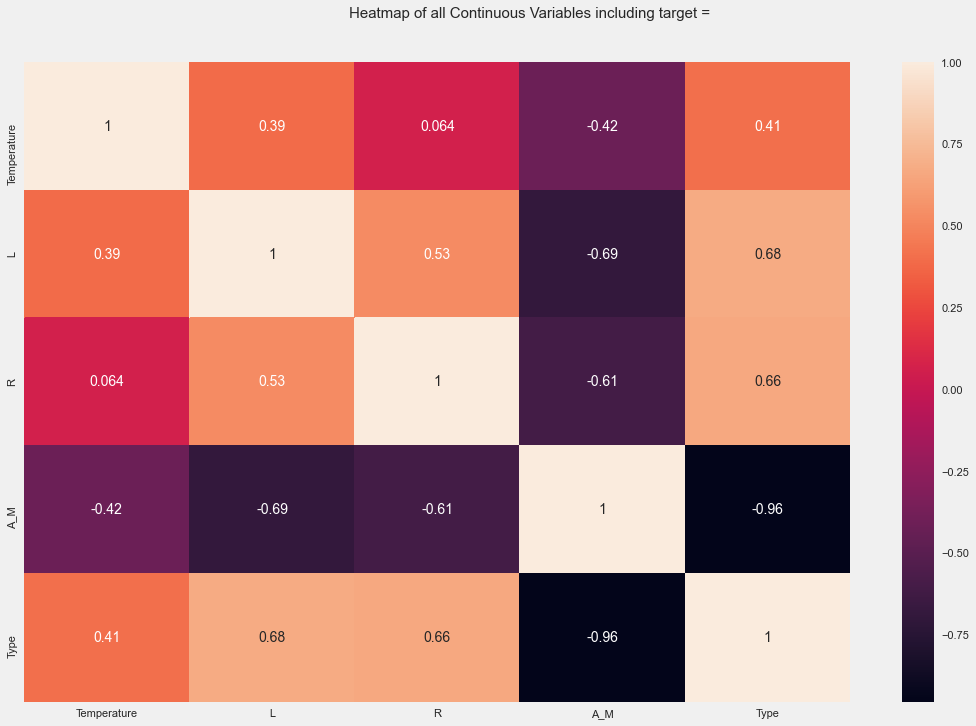

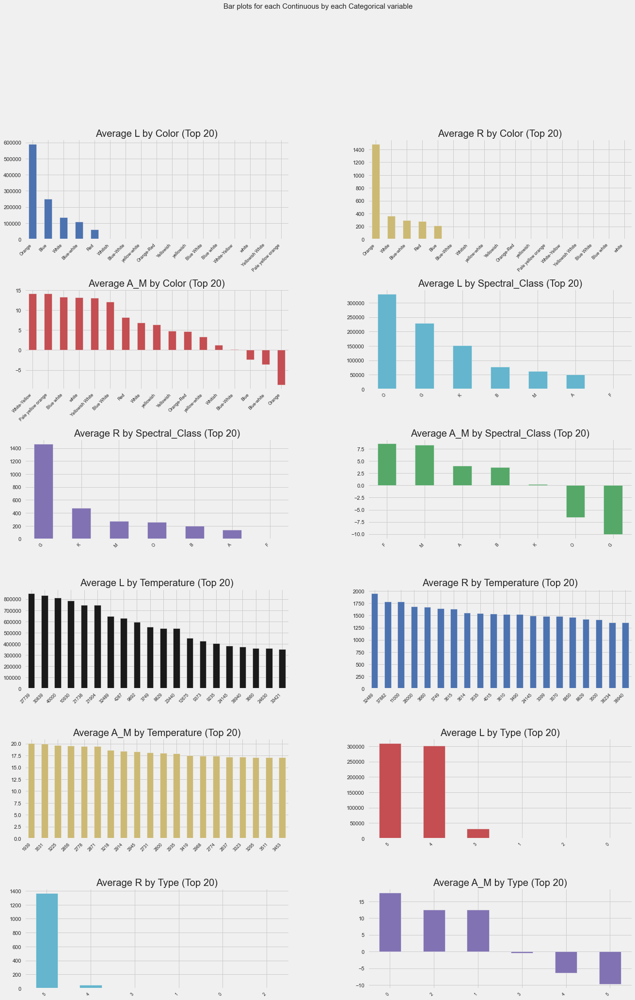

In [20]:
from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()
df_av = AV.AutoViz('Stars.csv')

# Basic Data Cleaning

In [21]:
df['Color'].value_counts()

Red                   112
Blue                   56
Blue-white             26
Blue White             10
yellow-white            8
White                   7
Blue white              4
white                   3
Yellowish White         3
yellowish               2
Whitish                 2
Orange                  2
White-Yellow            1
Pale yellow orange      1
Yellowish               1
Orange-Red              1
Blue-White              1
Name: Color, dtype: int64

In [22]:
a = ['Blue White','Blue white','Blue-White','white','Whitish','Yellowish White','yellowish','Yellowish','White-Yellow','Pale yellow orange','Orange-Red']
for i in range(len(df['Color'])):
    if df['Color'][i] in a[:3]:
        df['Color'][i] = 'Blue-white'
    elif df['Color'][i] in a[3:5]:
        df['Color'][i] = 'White'
    elif df['Color'][i] in a[5:9]:
        df['Color'][i] = 'yellow-white'
    elif df['Color'][i] in a[9:]:
        df['Color'][i] = 'Orange'

# Data Visualisation

## To show more realations in data I did around 200 visualisations

### Main idea behid this is first did visualisation for every color of stars.Then, seperated each color into one dataframe. for example,I created a dataframe which has only blue colored stars like wise did to every color. Next, In blue color classified according to spectral classes and did visualistaion on them using bar and histplot and also general visualisations using heat map,pair plot,scatter plot,box plot,vilolin plot etc..

In [23]:
df['Color'].value_counts()

Red             112
Blue             56
Blue-white       41
yellow-white     15
White            12
Orange            4
Name: Color, dtype: int64

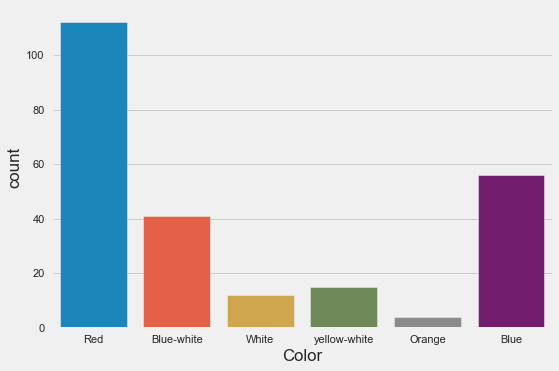

In [24]:
sns.countplot(x = 'Color',data = df)
plt.show()

In [25]:
df['Spectral_Class'].value_counts()

M    111
B     46
O     40
A     19
F     17
K      6
G      1
Name: Spectral_Class, dtype: int64

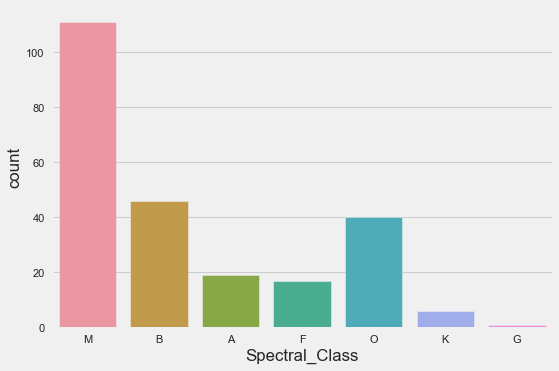

In [26]:
sns.countplot(x='Spectral_Class', data = df)
plt.show()

In [27]:
df['Type'].value_counts()

0    40
1    40
2    40
3    40
4    40
5    40
Name: Type, dtype: int64

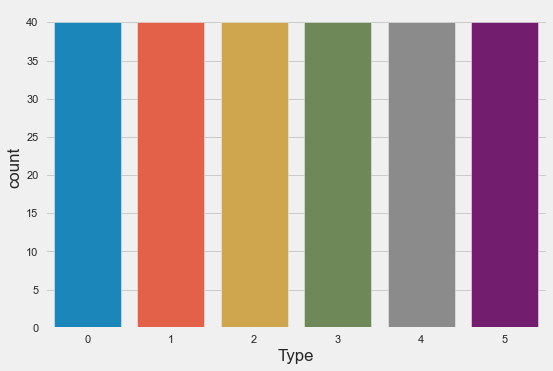

In [28]:
sns.countplot(x='Type', data = df)
plt.show()

In [29]:
fig = px.histogram(df, 'Temperature',             
                   color='Color',
                   title="<b>Average Temparature by color</b>")

fig.add_vline(x=df['Temperature'].mean(), line_width=2, line_dash="dash", line_color="black")

fig.show()

# all stars with red color are below 5000 temparture 
# only 6 blue stars outof 56 are lessthan 10k temparature 
# only 6 blue white stars ouof 41 are lessthan 10k temparature
# A Blue Star has highest temparature among all

In [30]:
fig = px.histogram(df, 'L',             
                   color='Color',
                   title="<b>Average Relative Luminocity by color</b>")

fig.add_vline(x=df['L'].mean(), line_width=2, line_dash="dash", line_color="black")

fig.show()

# around 160 stars outof 240 have less than 100k  Relative Luminocity
# A blue and a red star has greather Relative Luminocity among all

In [31]:
fig = px.histogram(df, 'R',             
                   color='Color',
                   title="<b>Average Relative Radius by color</b>")

fig.add_vline(x=df['R'].mean(), line_width=2, line_dash="dash", line_color="black")

fig.show()

# almost 200 outof 240 stars have relative radius between 0-1
# A blue star is bigger among all

In [32]:
fig = px.histogram(df, 'A_M',             
                   color='Color',
                   title="<b>Average Absolute Magnitude by color</b>")

fig.add_vline(x=df['A_M'].mean(), line_width=2, line_dash="dash", line_color="black")

fig.show()
# Couple of red stars has highest Absolute Magnitude am

In [33]:
fig = px.histogram(df, 'Temperature',             
                   color='Spectral_Class',
                   title="<b>Average Temparature by Spectral_Class</b>")

fig.add_vline(x=df['Temperature'].mean(), line_width=2, line_dash="dash", line_color="black")

fig.show()

# all stars with red color are below 5000 temparture 
# only 6 blue stars outof 56 are lessthan 10k temparature 
# only 6 blue white stars ouof 41 are lessthan 10k temparature
# A Blue Star has highest temparature among all

In [34]:
fig = px.histogram(df, 'L',             
                   color='Spectral_Class',
                   title="<b>Average Spectral_Class by color</b>")

fig.add_vline(x=df['L'].mean(), line_width=2, line_dash="dash", line_color="black")

fig.show()


In [35]:
fig = px.histogram(df, 'R',             
                   color='Spectral_Class',
                   title="<b>Average Spectral_Class by color</b>")

fig.add_vline(x=df['R'].mean(), line_width=2, line_dash="dash", line_color="black")

fig.show()


In [36]:
fig = px.histogram(df, 'A_M',             
                   color='Spectral_Class',
                   title="<b>Average Spectral_Class by color</b>")

fig.add_vline(x=df['A_M'].mean(), line_width=2, line_dash="dash", line_color="black")

fig.show()

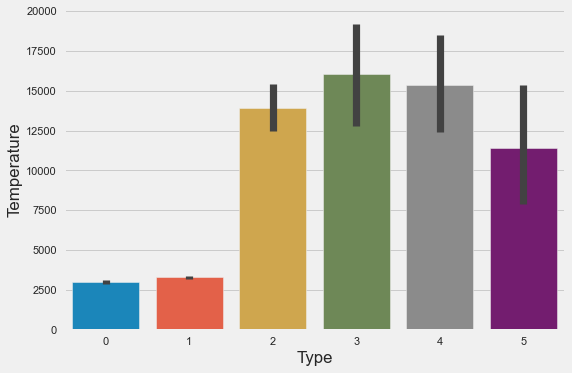

In [37]:
sns.barplot(data = df,x = 'Type',y ='Temperature')
plt.show()

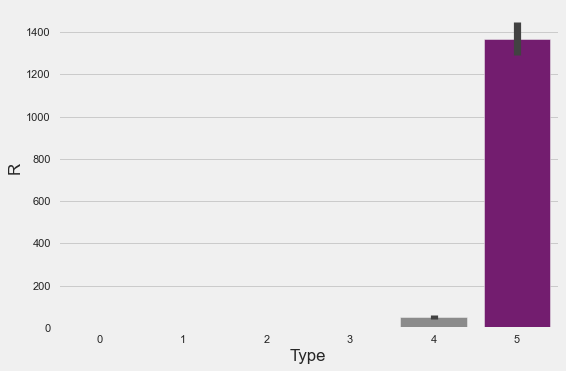

In [38]:
sns.barplot(data = df,x = 'Type',y ='R')
plt.show()

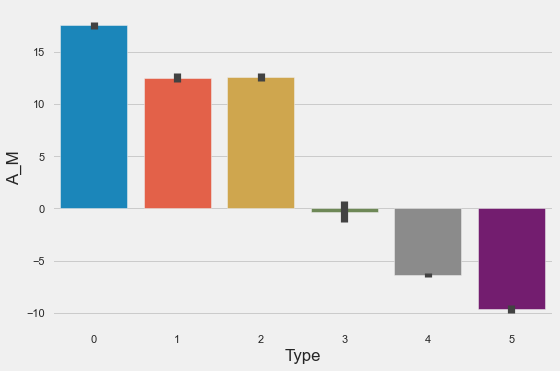

In [39]:
sns.barplot(data = df,x = 'Type',y ='A_M')
plt.show()

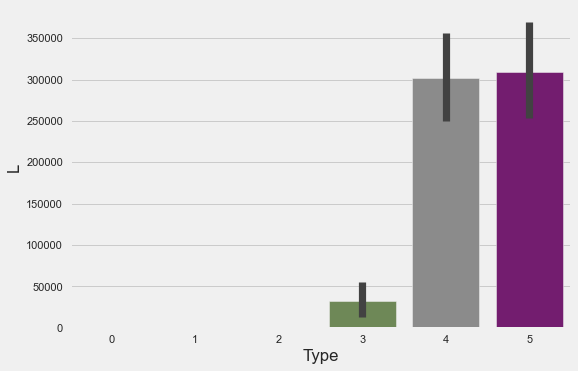

In [40]:
sns.barplot(data = df,x = 'Type',y ='L')
plt.show()

In [41]:
blue_df = df[df['Color'] == 'Blue']
blue_df# only blue color stars

,Temperature,L,R,A_M,Color,Spectral_Class,Type
30,39000,204000.00000,10.60000,-4.700,Blue,O,3
49,33750,220000.00000,26.00000,-6.100,Blue,B,4
89,19860,0.00110,0.01310,11.340,Blue,B,2
99,36108,198000.00000,10.20000,-4.400,Blue,O,3
100,33300,240000.00000,12.00000,-6.500,Blue,B,4
101,40000,813000.00000,14.00000,-6.230,Blue,O,4
102,23000,127000.00000,36.00000,-5.760,Blue,O,4
103,17120,235000.00000,83.00000,-6.890,Blue,O,4
104,11096,112000.00000,12.00000,-5.910,Blue,O,4
105,14245,231000.00000,42.00000,-6.120,Blue,O,4


In [42]:
blue_df['Spectral_Class'].value_counts()

O    40
B    16
Name: Spectral_Class, dtype: int64

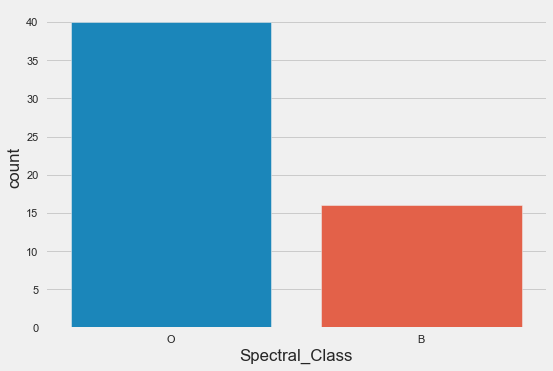

In [43]:
sns.countplot(x = 'Spectral_Class',data = blue_df)
plt.show()

# stars with color blue have spectral_class O

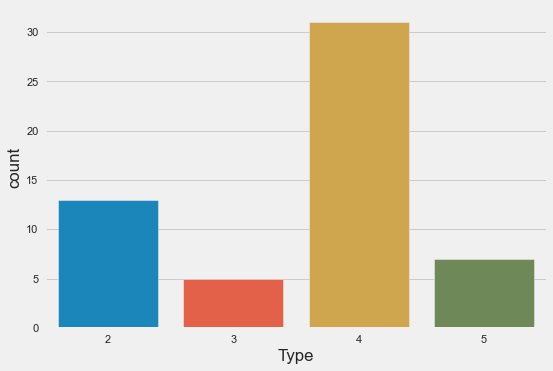

In [44]:
sns.countplot(x = 'Type',data = blue_df)
plt.show()

# In blue color stars most of them were type 4

In [45]:
blue_df.sort_values('Temperature').tail(10)

# In blue color stars the star with highest temperature is from Spectral_class O and of type 4

,Temperature,L,R,A_M,Color,Spectral_Class,Type
109,33421,352000.0,67.00,-5.79,Blue,O,4
49,33750,220000.0,26.00,-6.10,Blue,B,4
214,34190,198200.0,6.39,-4.57,Blue,O,3
99,36108,198000.0,10.20,-4.40,Blue,O,3
159,37800,202900.0,6.86,-4.56,Blue,O,3
239,37882,294903.0,1783.00,-7.80,Blue,O,5
231,38234,272830.0,1356.00,-9.29,Blue,O,5
235,38940,374830.0,1356.00,-9.93,Blue,O,5
30,39000,204000.0,10.60,-4.70,Blue,O,3
101,40000,813000.0,14.00,-6.23,Blue,O,4


In [46]:
blue_df.sort_values('Temperature').head()

# In blue color stars the star with lowest temperature is from Spectral_class O and of type 4

,Temperature,L,R,A_M,Color,Spectral_Class,Type
163,5752,245000.0,97.0,-6.63,Blue,O,4
165,7282,131000.0,24.0,-7.22,Blue,O,4
164,8927,239000.0,35.0,-7.34,Blue,O,4
169,9373,424520.0,24.0,-5.99,Blue,O,4
222,9383,342940.0,98.0,-6.98,Blue,O,4


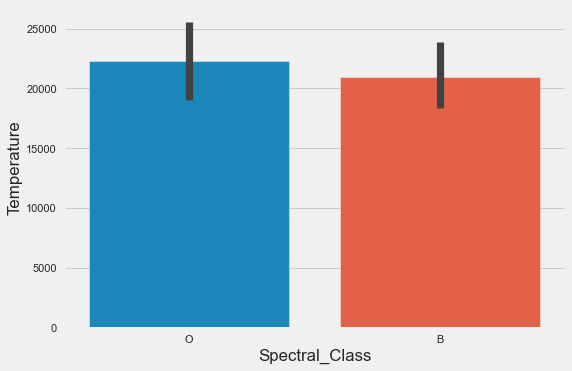

In [47]:
sns.barplot(x = 'Spectral_Class',y = 'Temperature',data = blue_df)
plt.show()

In [48]:
fig = px.histogram(blue_df, 'Temperature',             
                   color = 'Type')
fig.show()

# In blue color stars type 4 is in almost every temperature(except 35k-40k)
# In blue color stars type 2 varies between 10k - 25k temperature(most of them between 15k-20k)
# In blue color stars type 5 having high temparature from 25k - 40k
# There is no type 0 and type 1 in blue coloured stars

In [49]:
fig = px.histogram(blue_df, 'L',             
                   color = 'Type')
fig.show()

In [50]:
fig = px.histogram(blue_df, 'L',             
                   color = 'Spectral_Class')
fig.show()

In [51]:
fig = px.histogram(blue_df, 'R',             
                   color = 'Type')
fig.show()

In [52]:
fig = px.histogram(blue_df, 'R',             
                   color = 'Spectral_Class')
fig.show()

In [53]:
fig = px.histogram(blue_df, 'A_M',             
                   color = 'Type')
fig.show()

In [54]:
fig = px.histogram(blue_df, 'A_M',             
                   color = 'Spectral_Class')
fig.show()

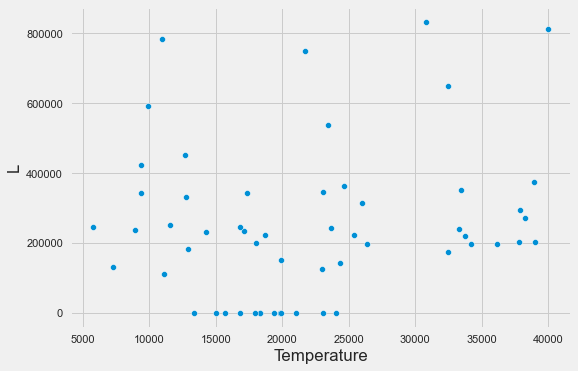

In [55]:
sns.scatterplot(x = 'Temperature',y = 'L',data = blue_df)
plt.show()

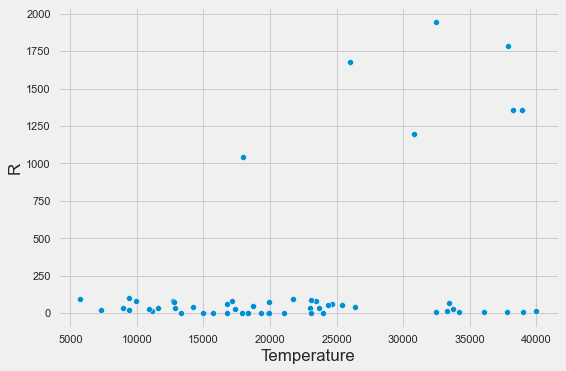

In [56]:
sns.scatterplot(x = 'Temperature',y = 'R',data = blue_df)
plt.show()

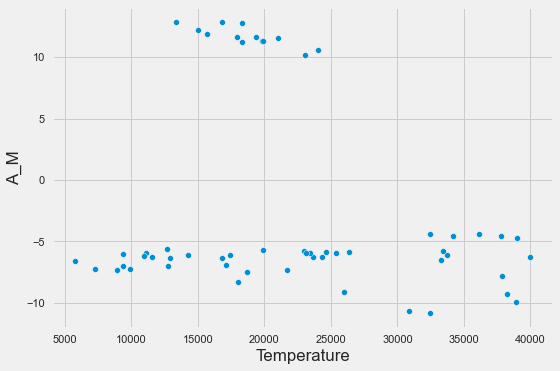

In [57]:
sns.scatterplot(x = 'Temperature',y = 'A_M',data = blue_df)
plt.show()

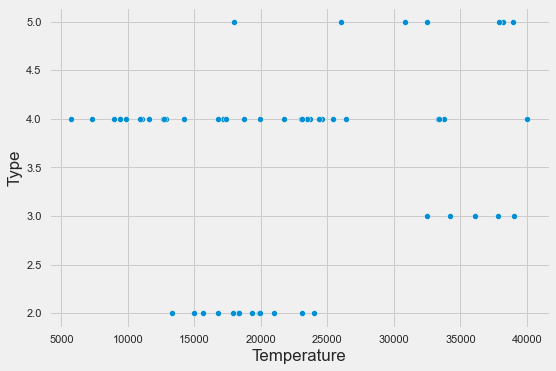

In [58]:
sns.scatterplot(x = 'Temperature',y = 'Type',data = blue_df)
plt.show()

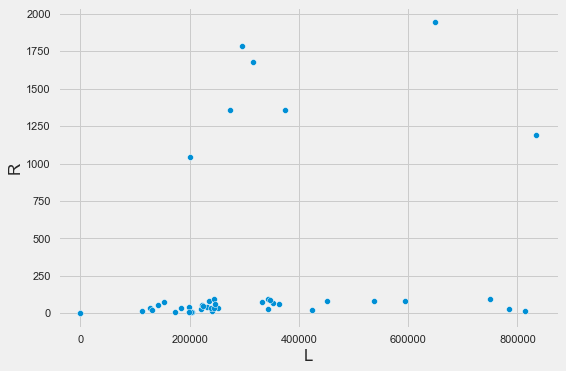

In [59]:
sns.scatterplot(x = 'L',y = 'R',data = blue_df)
plt.show()

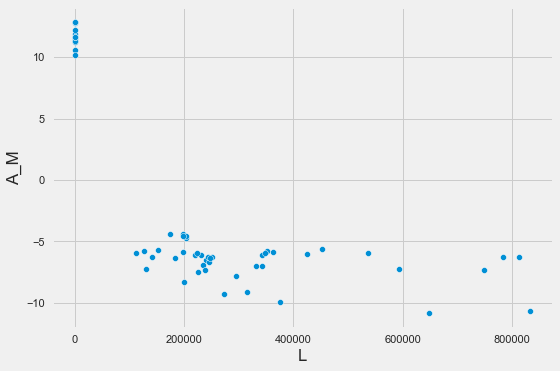

In [60]:
sns.scatterplot(x = 'L',y = 'A_M',data = blue_df)
plt.show()

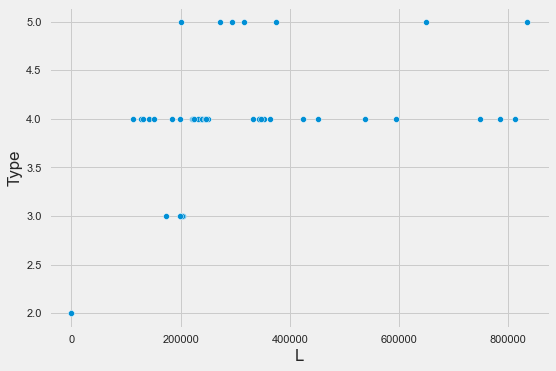

In [61]:
sns.scatterplot(x = 'L',y = 'Type',data = blue_df)
plt.show()

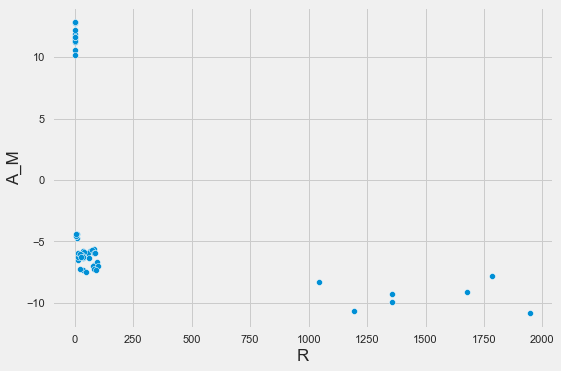

In [62]:
sns.scatterplot(x = 'R',y = 'A_M',data = blue_df)
plt.show()

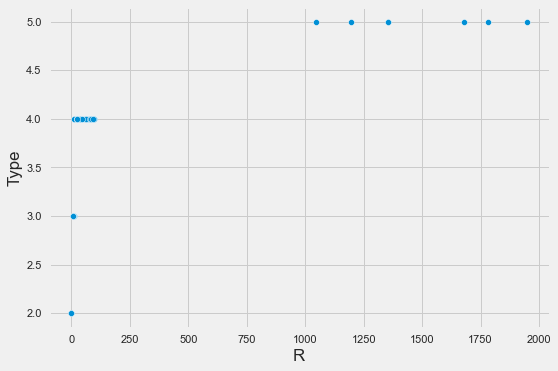

In [63]:
sns.scatterplot(x = 'R',y = 'Type',data =blue_df)
plt.show()

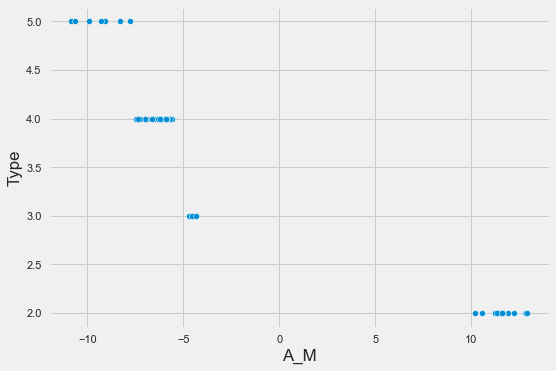

In [64]:
sns.scatterplot(x = 'A_M',y = 'Type',data = blue_df)
plt.show()

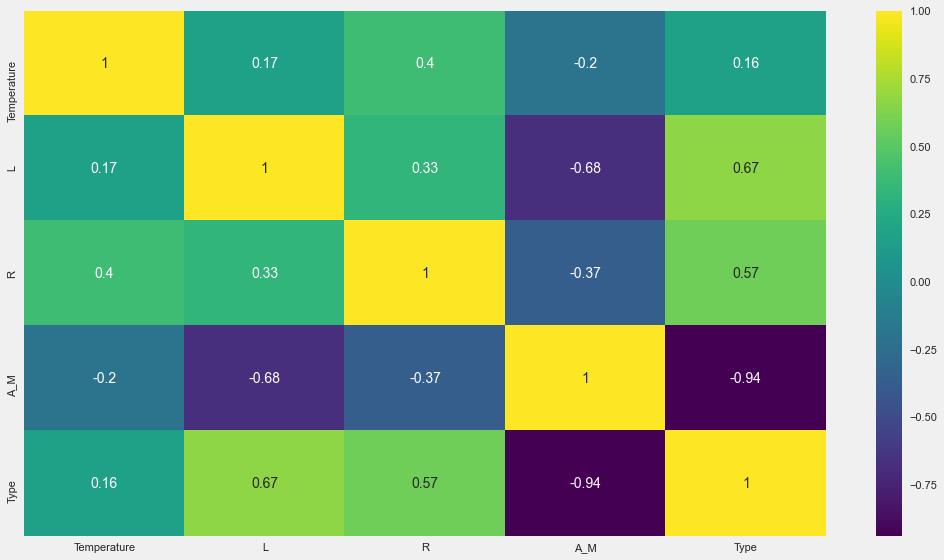

In [65]:
plt.figure(figsize=(16,9))
x = blue_df.drop(['Color','Spectral_Class'],axis = 1)
ax = sns.heatmap(blue_df.corr(),annot = True,cmap = 'viridis')
plt.show()

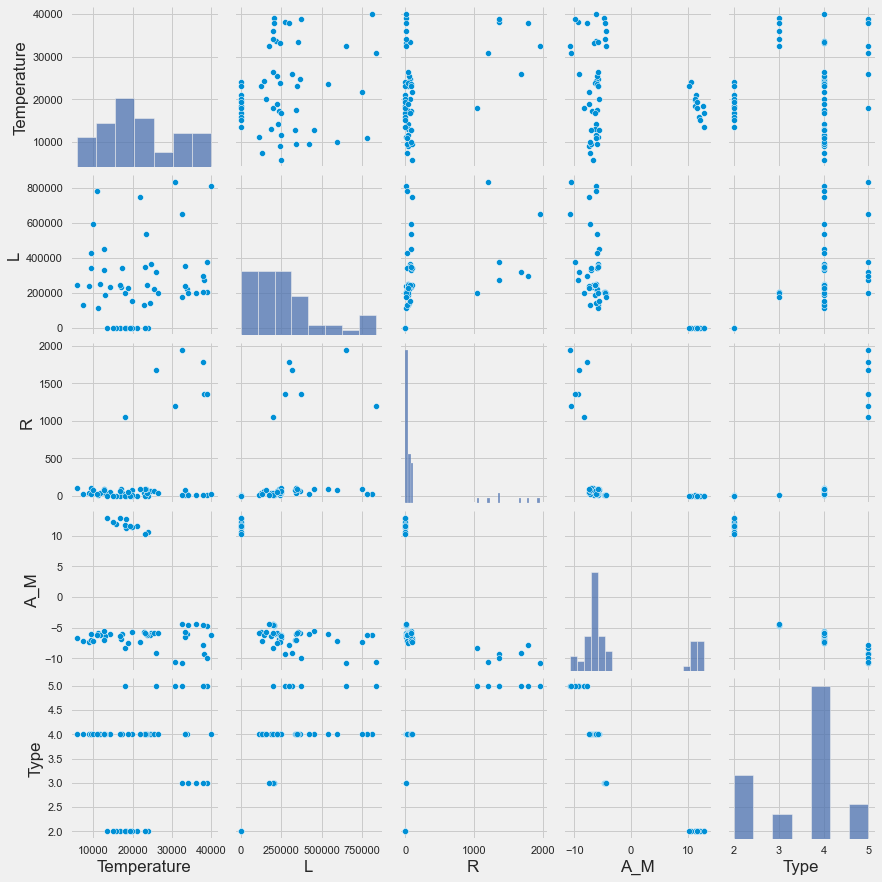

In [66]:
sns.pairplot(blue_df.drop(['Color','Spectral_Class'],axis = 1))

In [67]:
f = blue_df[blue_df['Spectral_Class'] == 'O']
f
# blue color stars with specral class O 

,Temperature,L,R,A_M,Color,Spectral_Class,Type
30,39000,204000.0,10.600,-4.700,Blue,O,3
99,36108,198000.0,10.200,-4.400,Blue,O,3
101,40000,813000.0,14.000,-6.230,Blue,O,4
102,23000,127000.0,36.000,-5.760,Blue,O,4
103,17120,235000.0,83.000,-6.890,Blue,O,4
104,11096,112000.0,12.000,-5.910,Blue,O,4
105,14245,231000.0,42.000,-6.120,Blue,O,4
106,24630,363000.0,63.000,-5.830,Blue,O,4
107,12893,184000.0,36.000,-6.340,Blue,O,4
108,24345,142000.0,57.000,-6.240,Blue,O,4


In [68]:
blue_df[blue_df['Spectral_Class'] == 'O']['Type'].value_counts()
# blue color stars with specral class O and count of all its types

4    29
5     6
3     5
Name: Type, dtype: int64

<AxesSubplot:xlabel='Type', ylabel='count'>

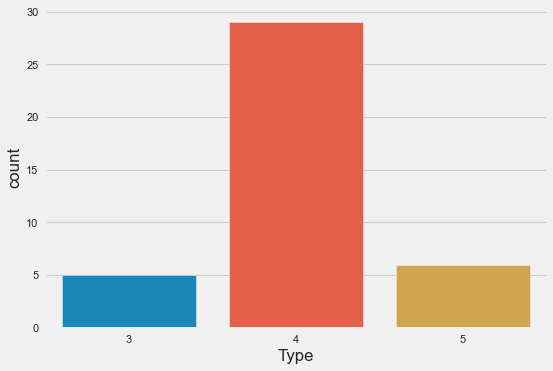

In [69]:
sns.countplot(x = 'Type',data = f)

#Most of the blue color stars with spectral class O are from type 4

In [70]:
fig = px.histogram(f, 'Temperature',             
                   color = 'Type')
fig.show()

In [71]:
fig = px.histogram(f, 'L',             
                   color = 'Type')
fig.show()

In [72]:
fig = px.histogram(f, 'R',             
                   color = 'Type')
fig.show()

In [73]:
fig = px.histogram(f, 'A_M',             
                   color = 'Type')
fig.show()

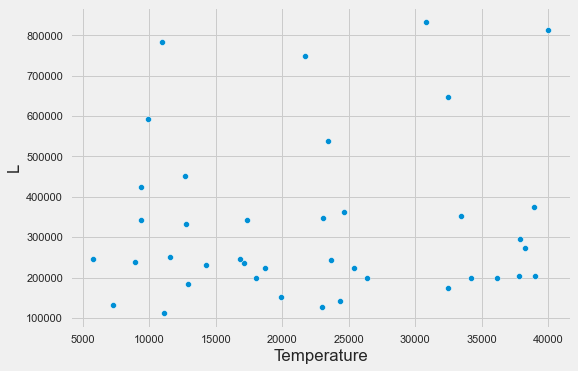

In [74]:
sns.scatterplot(x = 'Temperature',y = 'L',data = f)
plt.show()

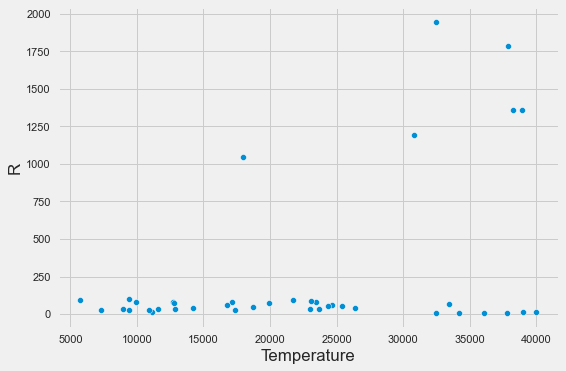

In [75]:
sns.scatterplot(x = 'Temperature',y = 'R',data = f)
plt.show()

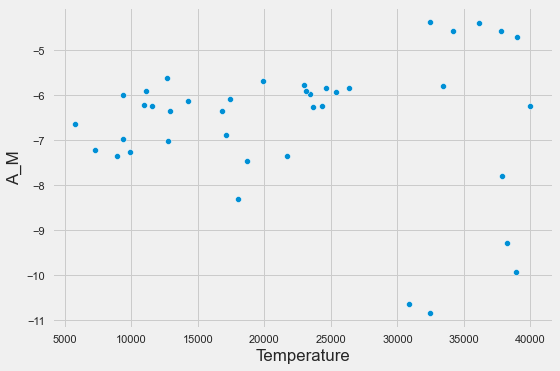

In [76]:
sns.scatterplot(x = 'Temperature',y = 'A_M',data = f)
plt.show()

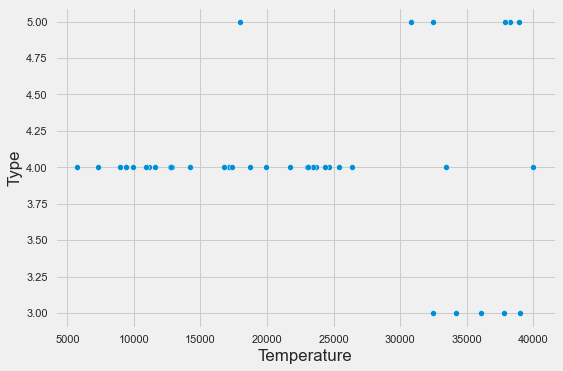

In [77]:
sns.scatterplot(x = 'Temperature',y = 'Type',data = f)
plt.show()

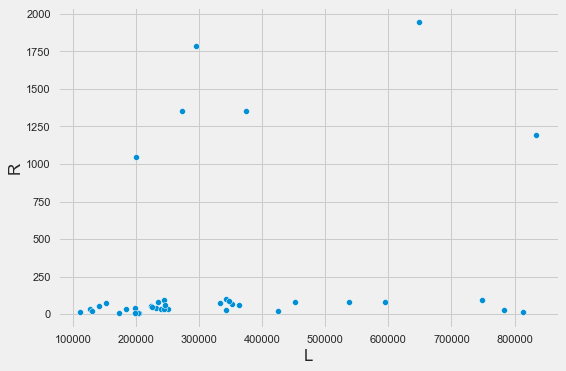

In [78]:
sns.scatterplot(x = 'L',y = 'R',data = f)
plt.show()

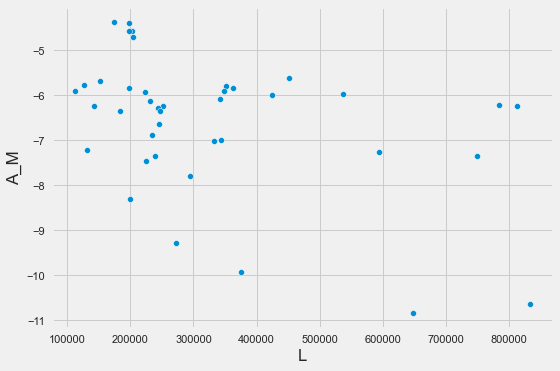

In [79]:
sns.scatterplot(x = 'L',y = 'A_M',data = f)
plt.show()

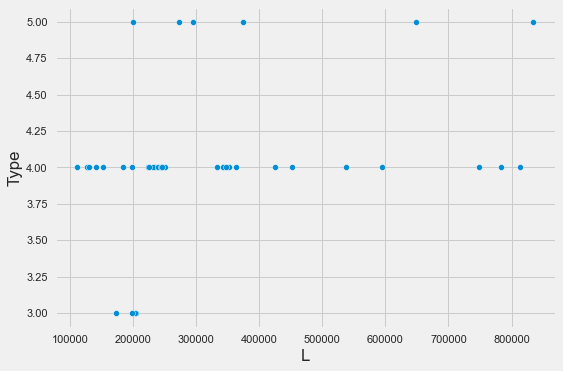

In [80]:
sns.scatterplot(x = 'L',y = 'Type',data = f)
plt.show()

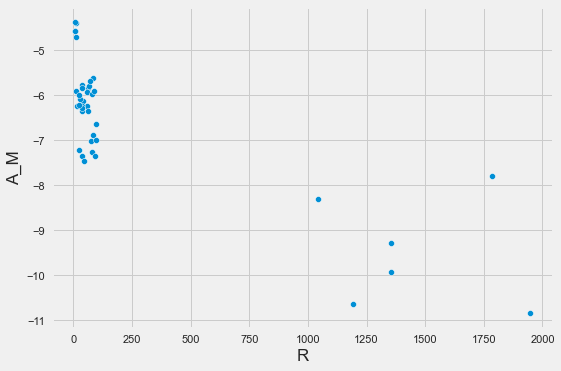

In [81]:
sns.scatterplot(x = 'R',y = 'A_M',data = f)
plt.show()

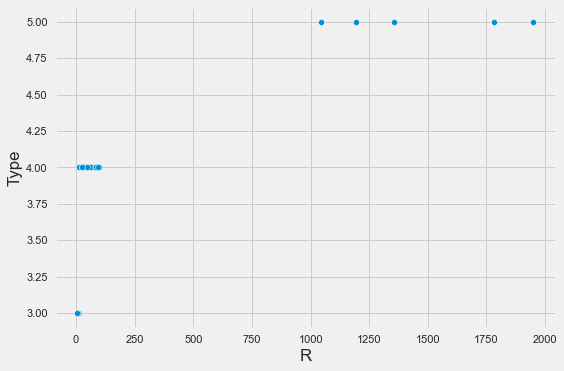

In [82]:
sns.scatterplot(x = 'R',y = 'Type',data = f)
plt.show()

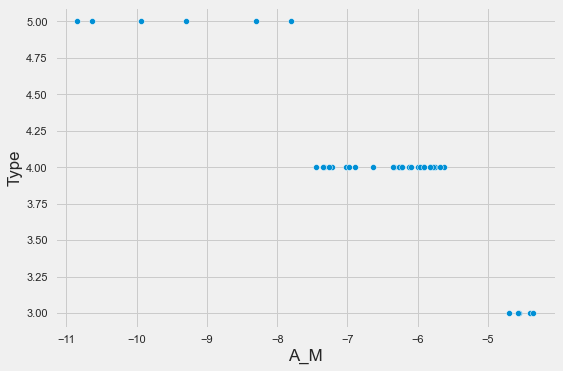

In [83]:
sns.scatterplot(x = 'A_M',y = 'Type',data = f)
plt.show()

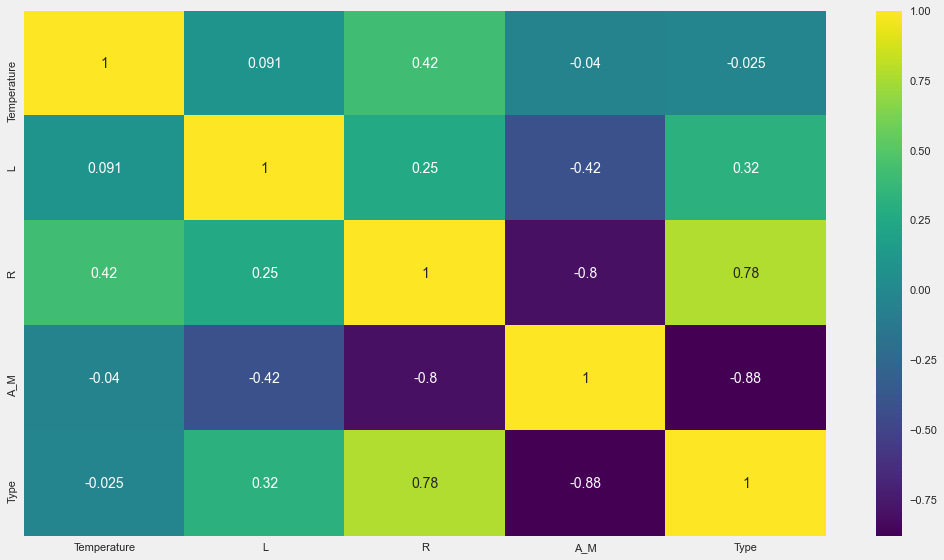

In [84]:
plt.figure(figsize=(16,9))
x = f.drop(['Color','Spectral_Class'],axis = 1)
ax = sns.heatmap(f.corr(),annot = True,cmap = 'viridis')
plt.show()

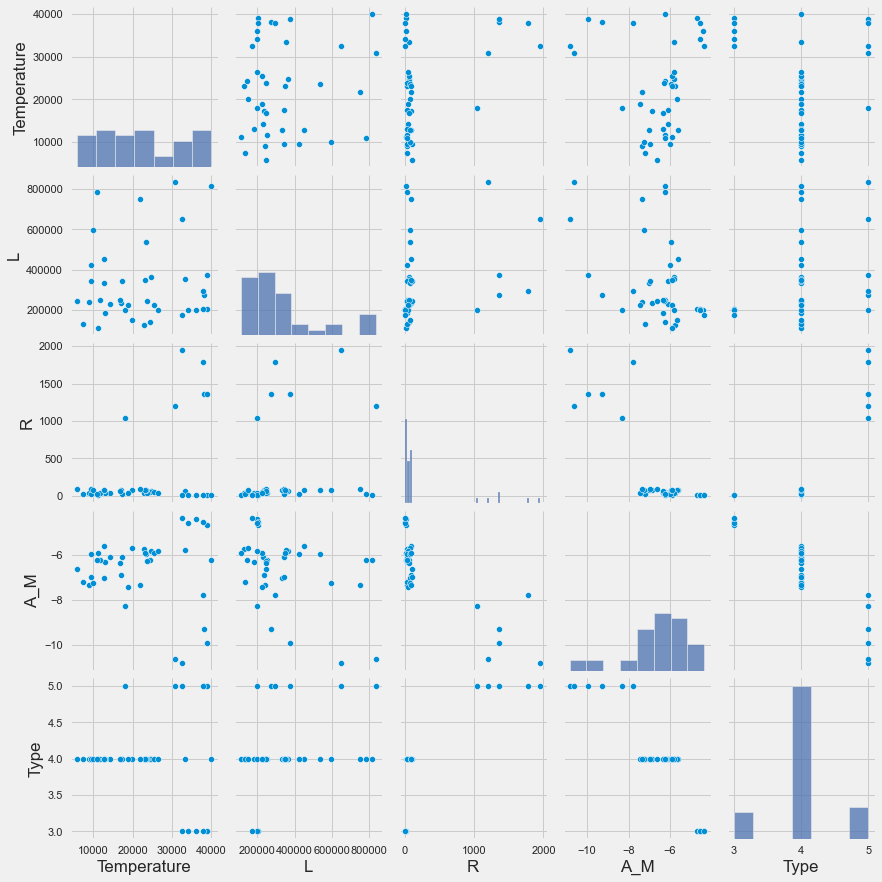

In [85]:
sns.pairplot(f.drop(['Color','Spectral_Class'],axis = 1))

In [86]:
g = blue_df[blue_df['Spectral_Class'] == 'B']
g
# blue color stars with specral class B

,Temperature,L,R,A_M,Color,Spectral_Class,Type
49,33750,220000.00000,26.00000,-6.10,Blue,B,4
89,19860,0.00110,0.01310,11.34,Blue,B,2
100,33300,240000.00000,12.00000,-6.50,Blue,B,4
141,21020,0.00150,0.01120,11.52,Blue,B,2
142,18290,0.00130,0.00934,12.78,Blue,B,2
173,26000,316000.00000,1679.00000,-9.10,Blue,B,5
200,16790,0.00140,0.01210,12.87,Blue,B,2
201,15680,0.00122,0.01140,11.92,Blue,B,2
202,14982,0.00118,0.01130,12.23,Blue,B,2
203,13340,0.00109,0.01160,12.90,Blue,B,2


In [87]:
blue_df[blue_df['Spectral_Class'] == 'B']['Type'].value_counts()
# blue color stars with specral class B and count of all its types

2    13
4     2
5     1
Name: Type, dtype: int64

<AxesSubplot:xlabel='Type', ylabel='count'>

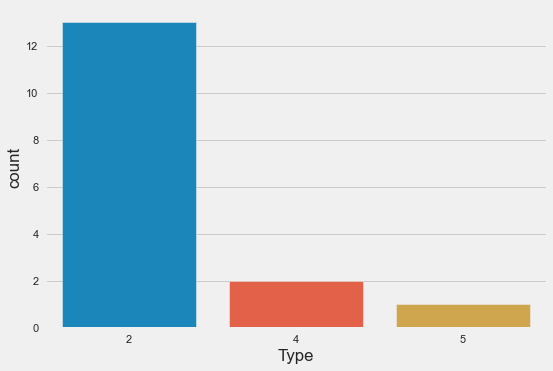

In [88]:
sns.countplot(x = 'Type',data = g)

#Most of the blue color stars with spectral class B are from type 2

In [89]:
fig = px.histogram(g, 'Temperature',             
                   color = 'Type')
fig.show()

In [90]:
fig = px.histogram(g, 'L',             
                   color = 'Type')
fig.show()

In [91]:
fig = px.histogram(g, 'R',             
                   color = 'Type')
fig.show()

In [92]:
fig = px.histogram(g, 'A_M',             
                   color = 'Type')
fig.show()

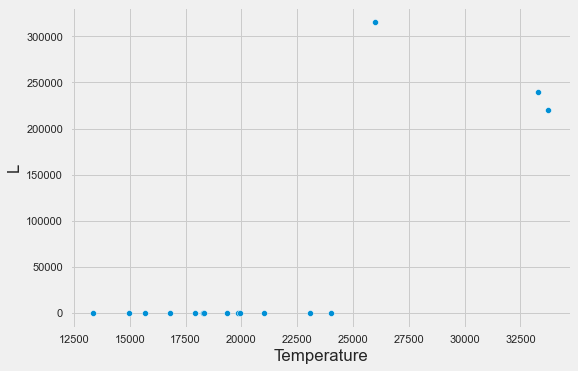

In [93]:
sns.scatterplot(x = 'Temperature',y = 'L',data = g)
plt.show()

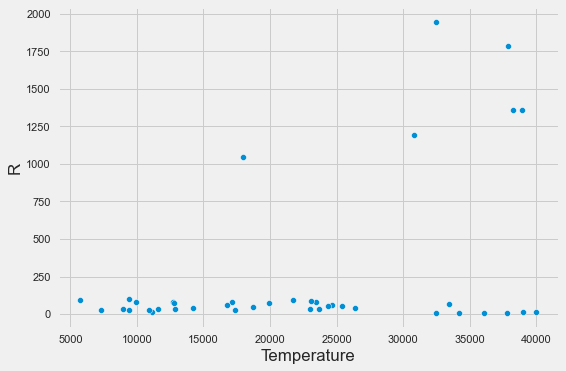

In [94]:
sns.scatterplot(x = 'Temperature',y = 'R',data = f)
plt.show()

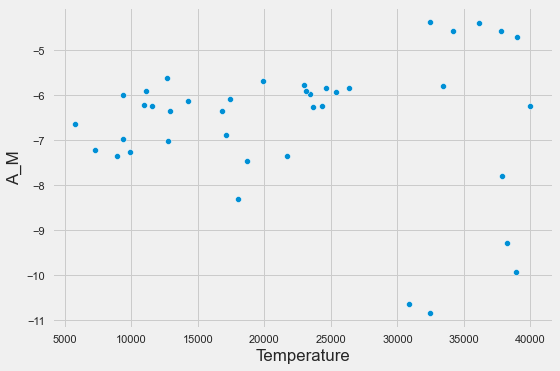

In [95]:
sns.scatterplot(x = 'Temperature',y = 'A_M',data = f)
plt.show()

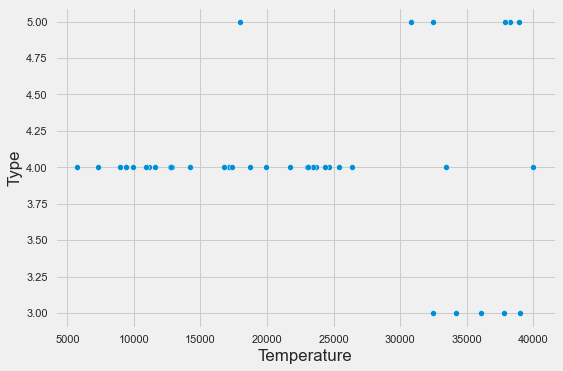

In [96]:
sns.scatterplot(x = 'Temperature',y = 'Type',data = f)
plt.show()

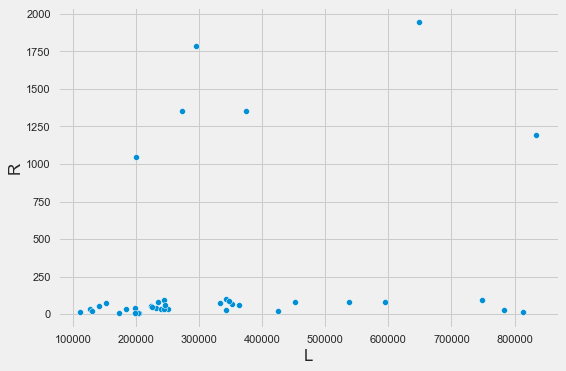

In [97]:
sns.scatterplot(x = 'L',y = 'R',data = f)
plt.show()

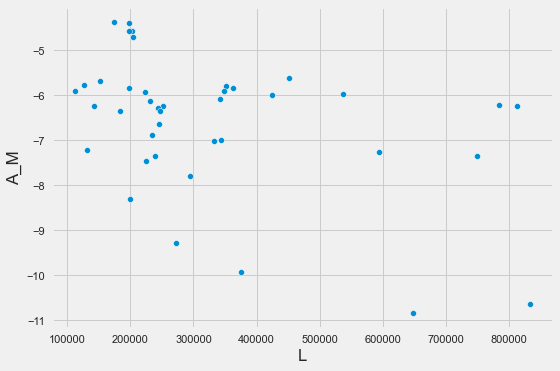

In [98]:
sns.scatterplot(x = 'L',y = 'A_M',data = f)
plt.show()

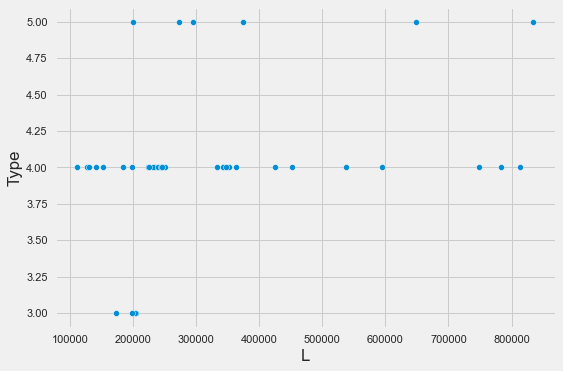

In [99]:
sns.scatterplot(x = 'L',y = 'Type',data = f)
plt.show()

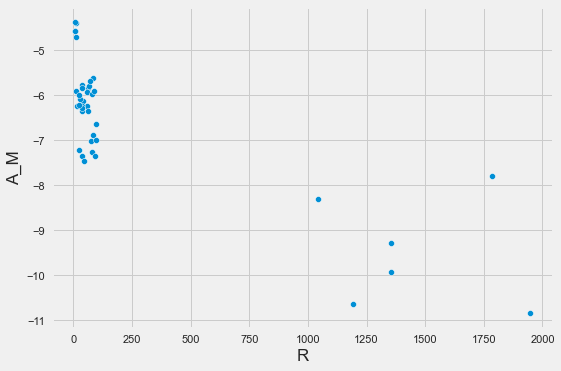

In [100]:
sns.scatterplot(x = 'R',y = 'A_M',data = f)
plt.show()

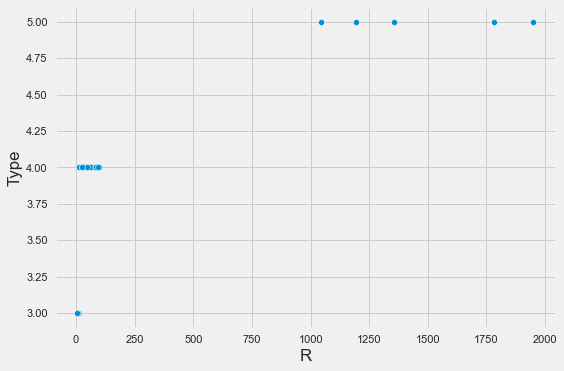

In [101]:
sns.scatterplot(x = 'R',y = 'Type',data = f)
plt.show()

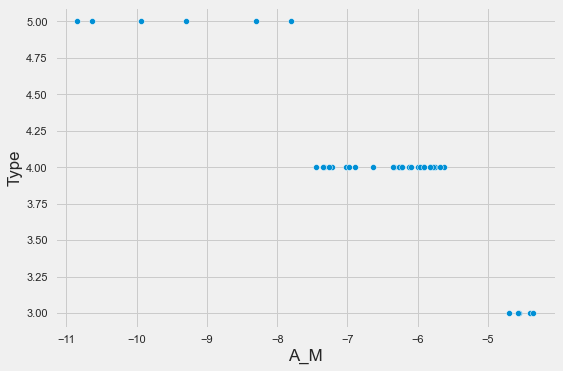

In [102]:
sns.scatterplot(x = 'A_M',y = 'Type',data = f)
plt.show()

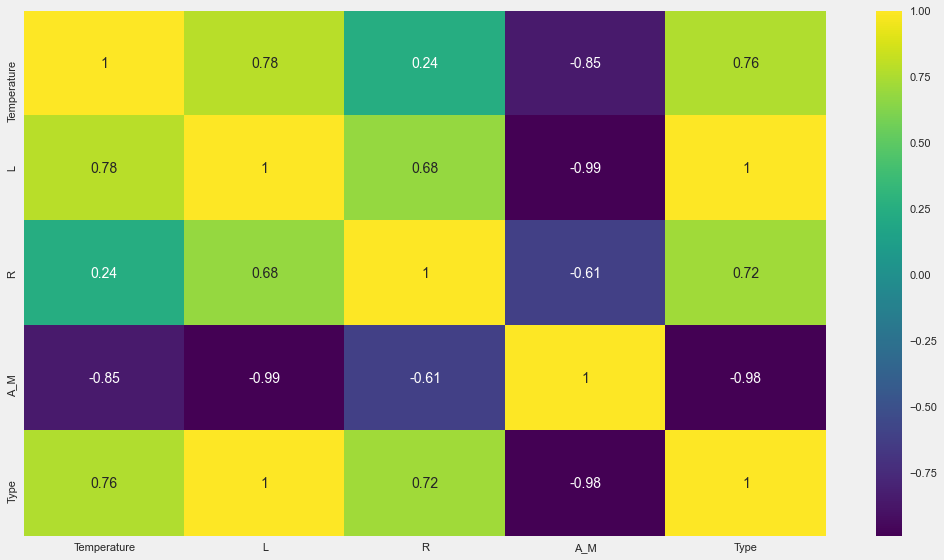

In [103]:
plt.figure(figsize=(16,9))
x = g.drop(['Color','Spectral_Class'],axis = 1)
ax = sns.heatmap(g.corr(),annot = True,cmap = 'viridis')
plt.show()

In [104]:
red_df = df[df['Color'] == 'Red']
red_df

,Temperature,L,R,A_M,Color,Spectral_Class,Type
0,3068,0.002400,0.1700,16.120,Red,M,0
1,3042,0.000500,0.1542,16.600,Red,M,0
2,2600,0.000300,0.1020,18.700,Red,M,0
3,2800,0.000200,0.1600,16.650,Red,M,0
4,1939,0.000138,0.1030,20.060,Red,M,0
...,...,...,...,...,...,...,...
195,3598,0.002700,0.6700,13.667,Red,M,1
196,3142,0.001320,0.2580,14.120,Red,M,1
197,3496,0.001250,0.3360,14.940,Red,M,1
198,3324,0.006500,0.4710,12.780,Red,M,1


In [105]:
red_df['Spectral_Class'].value_counts()

M    110
K      1
G      1
Name: Spectral_Class, dtype: int64

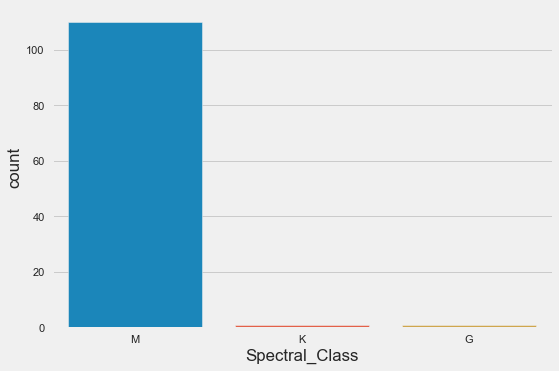

In [106]:
sns.countplot(x = 'Spectral_Class',data = red_df)
plt.show()

In [107]:
red_df['Type'].value_counts()

0    40
1    40
5    23
4     9
Name: Type, dtype: int64

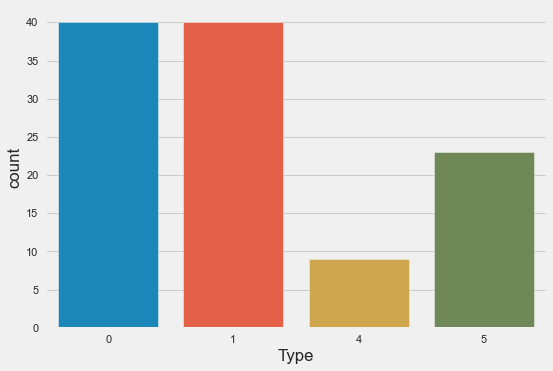

In [108]:
sns.countplot(x = 'Type',data = red_df)
plt.show()

In [109]:
red_df.sort_values('Temperature').tail(10)

,Temperature,L,R,A_M,Color,Spectral_Class,Type
54,3650,310000.00000,1324.00,-7.79,Red,M,5
56,3660,363000.00000,1673.00,-11.92,Red,M,5
17,3692,0.00367,0.47,10.80,Red,M,1
51,3750,283000.00000,1260.00,-7.63,Red,M,5
58,3752,209000.00000,955.00,-11.24,Red,M,5
119,3780,200000.00000,1324.00,-10.70,Red,M,5
40,3826,200000.00000,19.00,-6.93,Red,M,4
52,3834,272000.00000,1183.00,-9.20,Red,M,5
116,4015,282000.00000,1534.00,-11.39,Red,K,5
118,6850,229000.00000,1467.00,-10.07,Red,G,5


In [110]:
red_df.sort_values('Temperature').head(10)

,Temperature,L,R,A_M,Color,Spectral_Class,Type
4,1939,0.000138,0.1030,20.060,Red,M,0
2,2600,0.000300,0.1020,18.700,Red,M,0
7,2600,0.000400,0.0960,17.400,Red,M,0
78,2621,0.000600,0.0980,12.810,Red,M,1
6,2637,0.000730,0.1270,17.220,Red,M,0
8,2650,0.000690,0.1100,17.450,Red,M,0
14,2650,0.000600,0.1400,11.782,Red,M,1
9,2700,0.000180,0.1300,16.050,Red,M,0
129,2731,0.000437,0.0856,18.090,Red,M,0
68,2774,0.000360,0.1180,17.390,Red,M,0


In [111]:
fig = px.histogram(red_df, 'Temperature',             
                   color = 'Spectral_Class')
fig.show()

In [112]:
fig = px.histogram(red_df, 'Temperature',             
                   color = 'Type')
fig.show()

In [113]:
fig = px.histogram(red_df, 'L',             
                   color = 'Type')
fig.show()

In [114]:
fig = px.histogram(red_df, 'L',             
                   color = 'Spectral_Class')
fig.show()

In [115]:
fig = px.histogram(red_df, 'R',             
                   color = 'Type')
fig.show()

In [116]:
fig = px.histogram(red_df, 'R',             
                   color = 'Spectral_Class')
fig.show()

In [117]:
fig = px.histogram(red_df, 'A_M',             
                   color = 'Type')
fig.show()

In [118]:
fig = px.histogram(red_df, 'A_M',             
                   color = 'Spectral_Class')
fig.show()

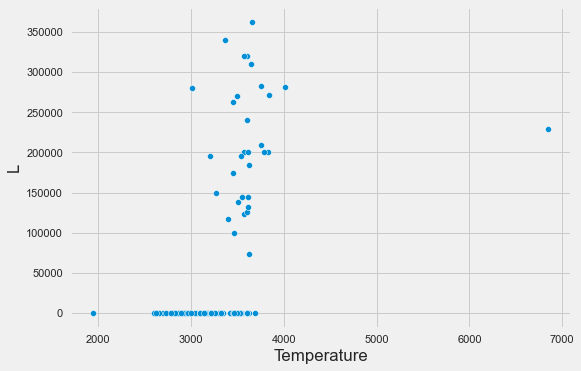

In [119]:
sns.scatterplot(x = 'Temperature',y = 'L',data = red_df)
plt.show()

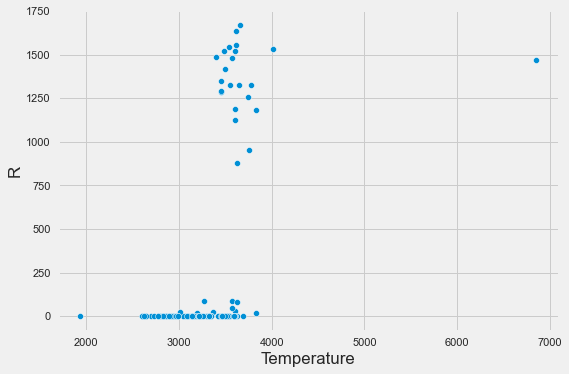

In [120]:
sns.scatterplot(x = 'Temperature',y = 'R',data = red_df)
plt.show()

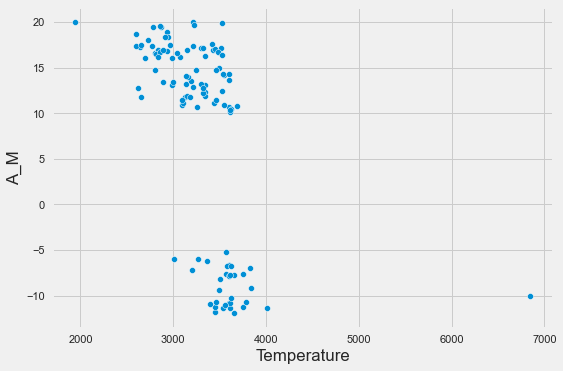

In [121]:
sns.scatterplot(x = 'Temperature',y = 'A_M',data = red_df)
plt.show()

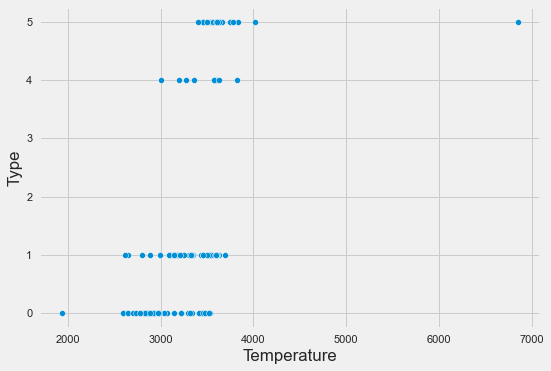

In [122]:
sns.scatterplot(x = 'Temperature',y = 'Type',data = red_df)
plt.show()

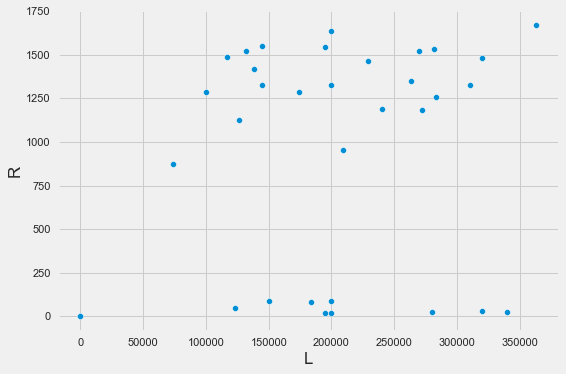

In [123]:
sns.scatterplot(x = 'L',y = 'R',data = red_df)
plt.show()

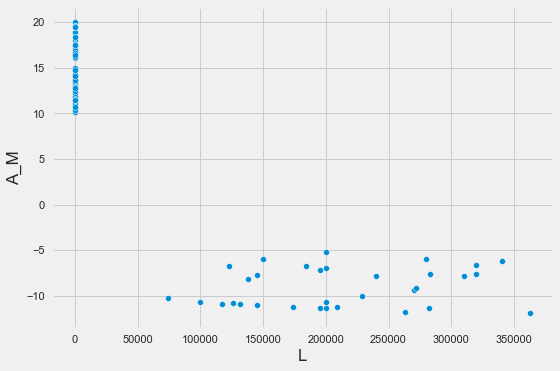

In [124]:
sns.scatterplot(x = 'L',y = 'A_M',data = red_df)
plt.show()

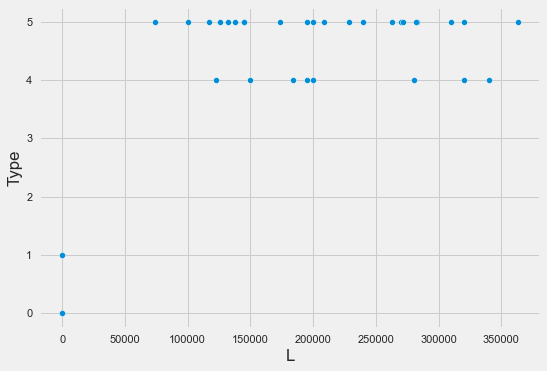

In [125]:
sns.scatterplot(x = 'L',y = 'Type',data = red_df)
plt.show()

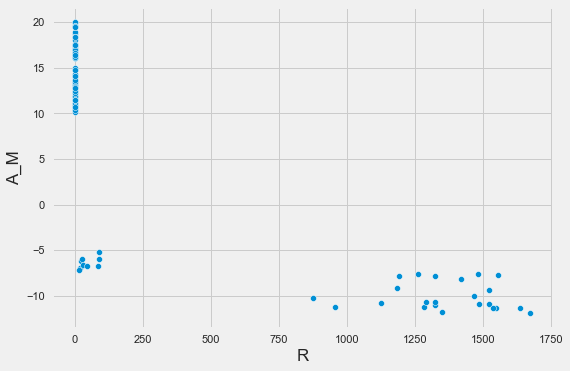

In [126]:
sns.scatterplot(x = 'R',y = 'A_M',data = red_df)
plt.show()

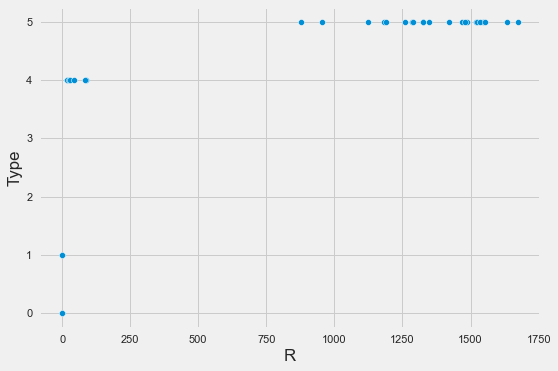

In [127]:
sns.scatterplot(x = 'R',y = 'Type',data =red_df)
plt.show()

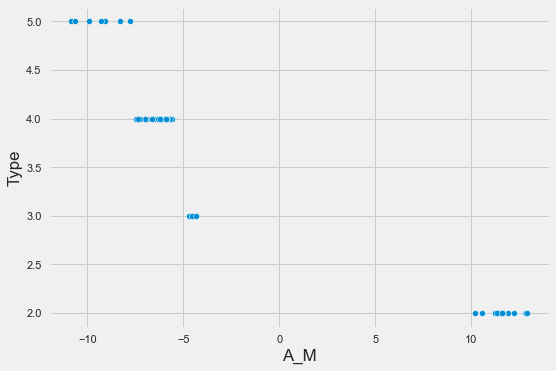

In [128]:
sns.scatterplot(x = 'A_M',y = 'Type',data = blue_df)
plt.show()

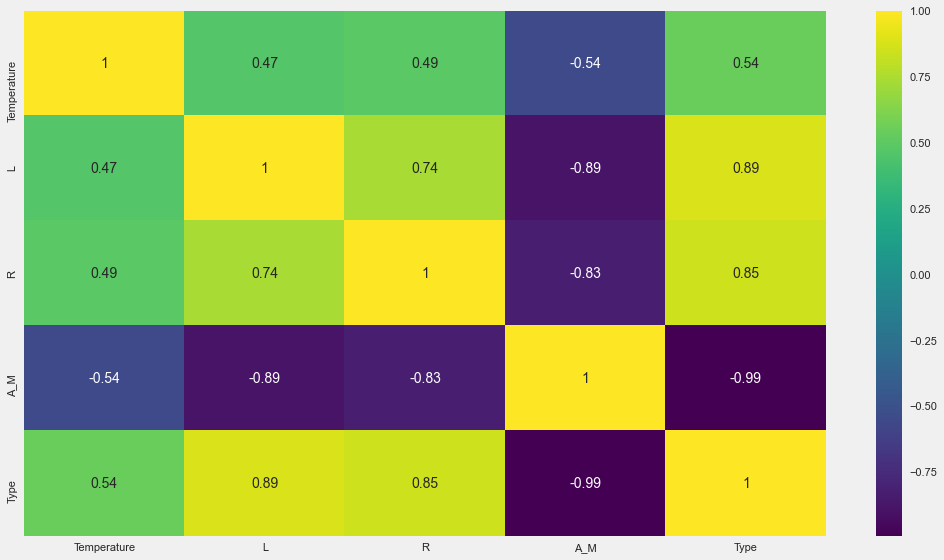

In [129]:
plt.figure(figsize=(16,9))
x = red_df.drop(['Color','Spectral_Class'],axis = 1)
ax = sns.heatmap(red_df.corr(),annot = True,cmap = 'viridis')
plt.show()

In [130]:
p = red_df[red_df['Spectral_Class'] == 'M']
p

,Temperature,L,R,A_M,Color,Spectral_Class,Type
0,3068,0.002400,0.1700,16.120,Red,M,0
1,3042,0.000500,0.1542,16.600,Red,M,0
2,2600,0.000300,0.1020,18.700,Red,M,0
3,2800,0.000200,0.1600,16.650,Red,M,0
4,1939,0.000138,0.1030,20.060,Red,M,0
...,...,...,...,...,...,...,...
195,3598,0.002700,0.6700,13.667,Red,M,1
196,3142,0.001320,0.2580,14.120,Red,M,1
197,3496,0.001250,0.3360,14.940,Red,M,1
198,3324,0.006500,0.4710,12.780,Red,M,1


In [131]:
red_df[red_df['Spectral_Class'] == 'M']['Type'].value_counts()

0    40
1    40
5    21
4     9
Name: Type, dtype: int64

<AxesSubplot:xlabel='Type', ylabel='count'>

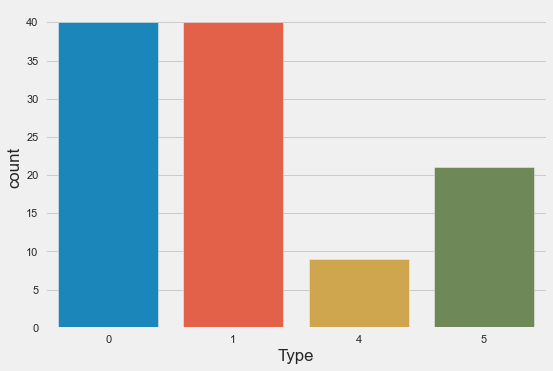

In [132]:
sns.countplot(x = 'Type',data = p)

In [133]:
fig = px.histogram(p, 'Temperature',             
                   color = 'Type')
fig.show()

In [134]:
fig = px.histogram(p, 'L',             
                   color = 'Type')
fig.show()

In [135]:
fig = px.histogram(p, 'R',             
                   color = 'Type')
fig.show()

In [136]:
fig = px.histogram(p, 'A_M',             
                   color = 'Type')
fig.show()

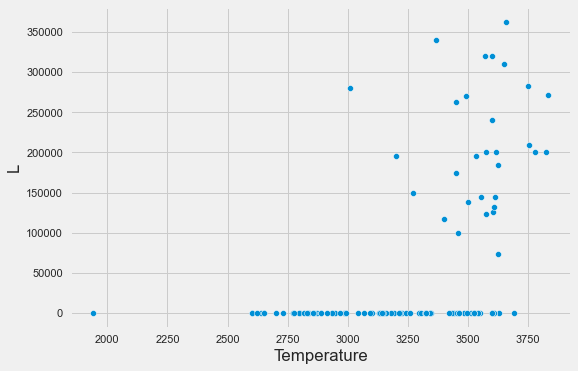

In [137]:
sns.scatterplot(x = 'Temperature',y = 'L',data = p)
plt.show()

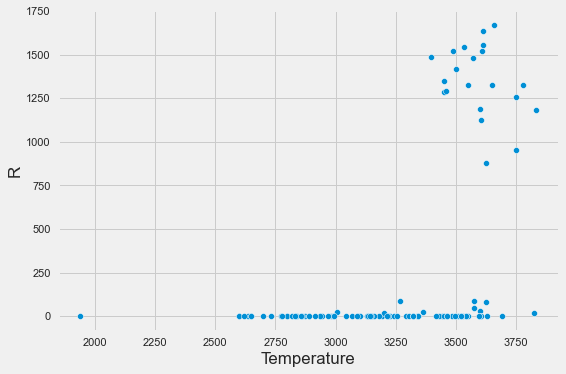

In [138]:
sns.scatterplot(x = 'Temperature',y = 'R',data = p)
plt.show()

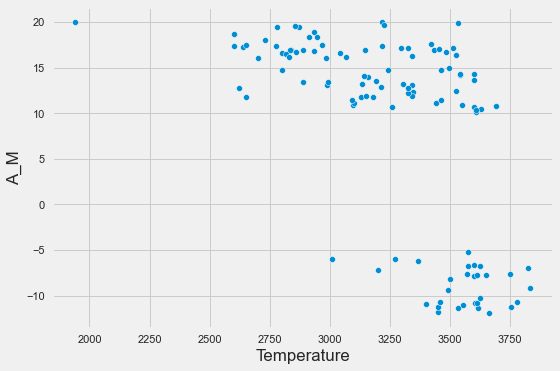

In [139]:
sns.scatterplot(x = 'Temperature',y = 'A_M',data = p)
plt.show()

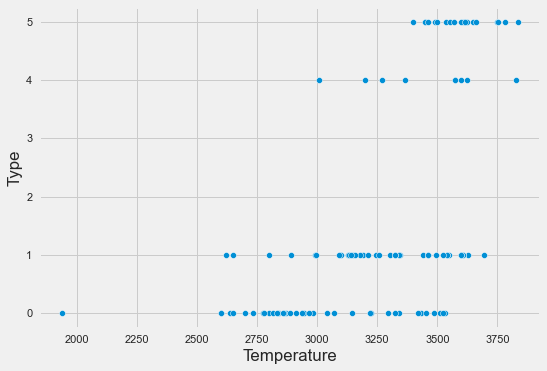

In [140]:
sns.scatterplot(x = 'Temperature',y = 'Type',data = p)
plt.show()

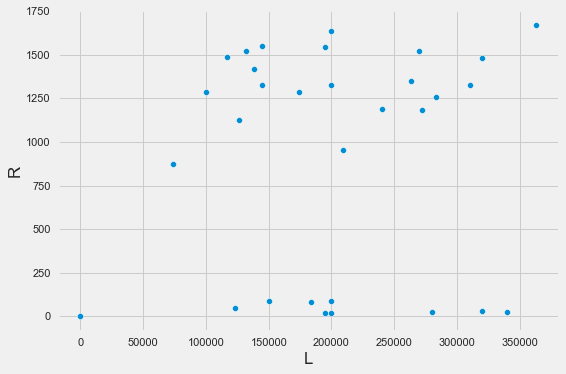

In [141]:
sns.scatterplot(x = 'L',y = 'R',data = p)
plt.show()

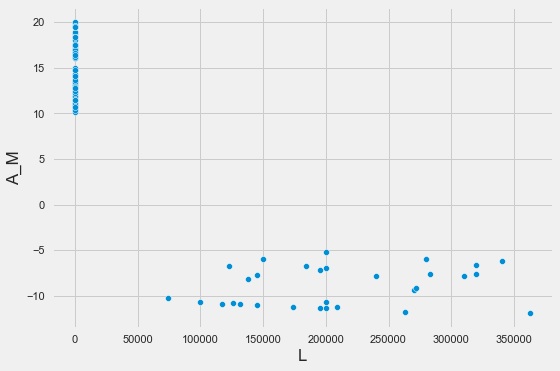

In [142]:
sns.scatterplot(x = 'L',y = 'A_M',data = p)
plt.show()

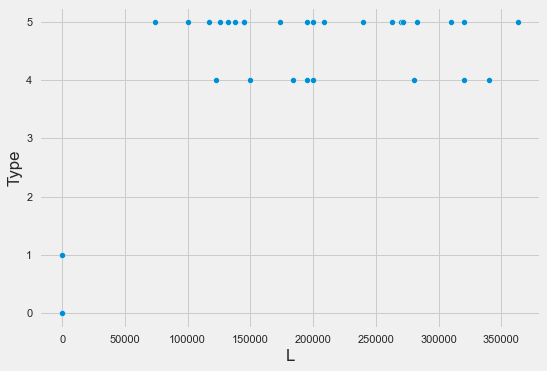

In [143]:
sns.scatterplot(x = 'L',y = 'Type',data = p)
plt.show()

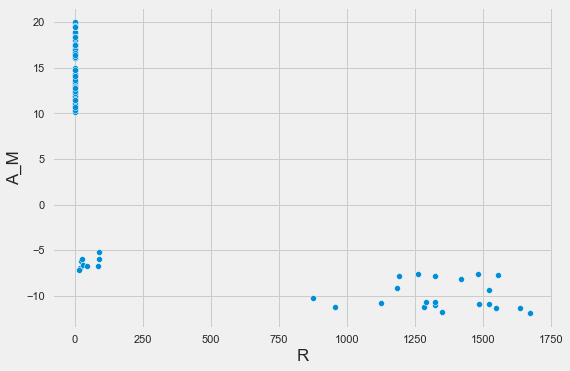

In [144]:
sns.scatterplot(x = 'R',y = 'A_M',data = p)
plt.show()

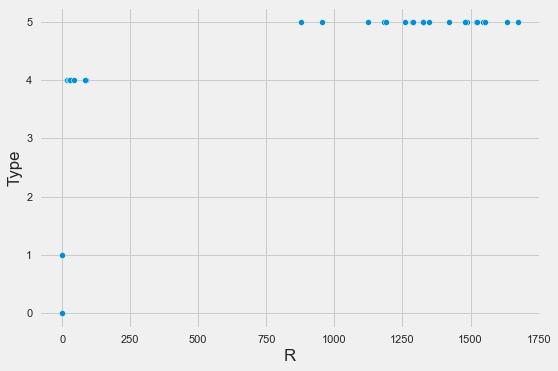

In [145]:
sns.scatterplot(x = 'R',y = 'Type',data = p)
plt.show()

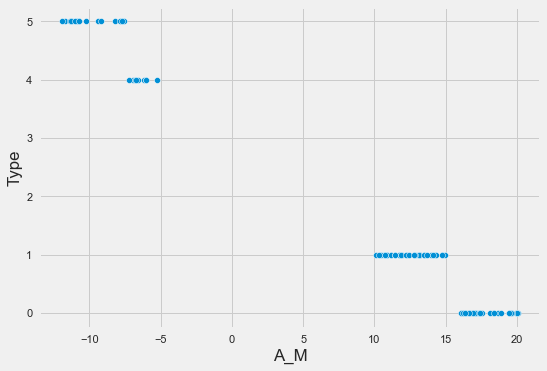

In [146]:
sns.scatterplot(x = 'A_M',y = 'Type',data = p)
plt.show()

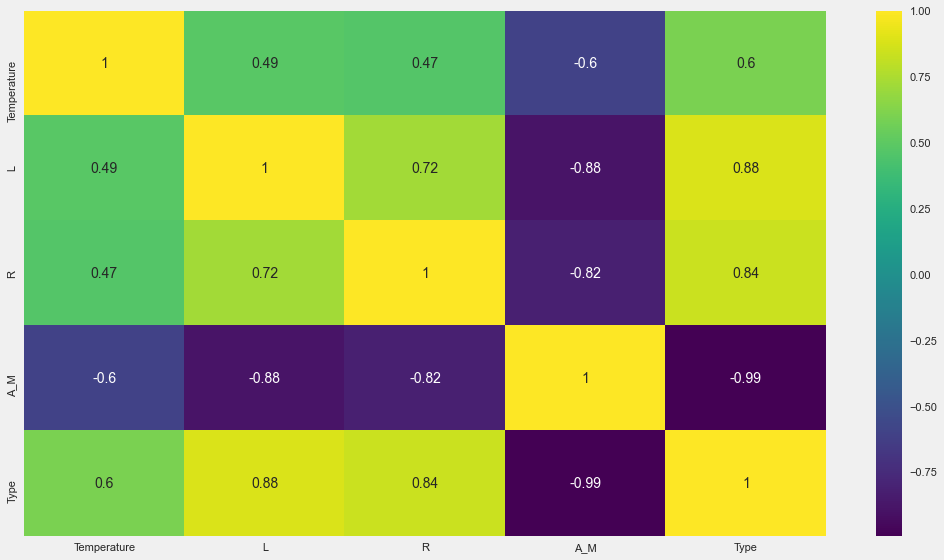

In [147]:
plt.figure(figsize=(16,9))
x = p.drop(['Color','Spectral_Class'],axis = 1)
ax = sns.heatmap(x.corr(),annot = True,cmap = 'viridis')
plt.show()

In [148]:
s = red_df[red_df['Spectral_Class'] == 'K']
s

,Temperature,L,R,A_M,Color,Spectral_Class,Type
116,4015,282000.0,1534.0,-11.39,Red,K,5


In [149]:
n = red_df[red_df['Spectral_Class'] == 'G']
n

,Temperature,L,R,A_M,Color,Spectral_Class,Type
118,6850,229000.0,1467.0,-10.07,Red,G,5


In [150]:
bluew_df = df[df['Color'] == 'Blue-white']
bluew_df

,Temperature,L,R,A_M,Color,Spectral_Class,Type
20,25000,0.05600,0.00840,10.580,Blue-white,B,2
24,16500,0.01300,0.01400,11.890,Blue-white,B,2
26,8570,0.00081,0.00970,14.200,Blue-white,A,2
31,30000,28840.00000,6.30000,-4.200,Blue-white,B,3
32,15276,1136.00000,7.20000,-1.970,Blue-white,B,3
83,17200,0.00098,0.01500,12.450,Blue-white,B,2
84,14100,0.00067,0.00890,12.170,Blue-white,B,2
85,9675,0.00045,0.01090,13.980,Blue-white,A,2
86,12010,0.00078,0.00920,12.130,Blue-white,B,2
87,10980,0.00074,0.00870,11.190,Blue-white,B,2


In [151]:
bluew_df['Spectral_Class'].value_counts()

B    29
A    12
Name: Spectral_Class, dtype: int64

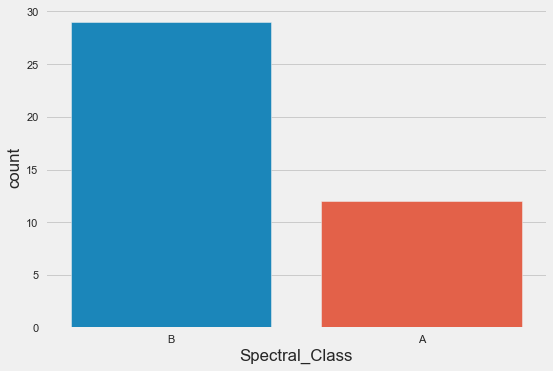

In [152]:
sns.countplot(x = 'Spectral_Class',data = bluew_df)
plt.show()


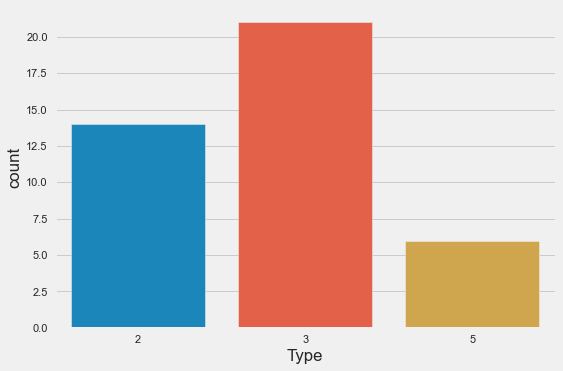

In [153]:
sns.countplot(x = 'Type',data = bluew_df)
plt.show()

In [154]:
bluew_df.sort_values('Temperature').tail(10)

,Temperature,L,R,A_M,Color,Spectral_Class,Type
210,22350,12450.000,6.3600,-3.67,Blue-white,B,3
230,24145,382993.000,1494.0000,-8.84,Blue-white,B,5
179,24490,248490.000,1134.5000,-8.24,Blue-white,B,5
20,25000,0.056,0.0084,10.58,Blue-white,B,2
154,25070,14500.000,5.9200,-3.98,Blue-white,B,3
156,26140,14520.000,5.4900,-3.80,Blue-white,B,3
233,27739,849420.000,1252.0000,-7.59,Blue-white,B,5
155,28700,16790.000,6.4000,-4.09,Blue-white,B,3
150,29560,188000.000,6.0200,-4.01,Blue-white,B,3
31,30000,28840.000,6.3000,-4.20,Blue-white,B,3


In [155]:
blue_df.sort_values('Temperature').head(10)

,Temperature,L,R,A_M,Color,Spectral_Class,Type
163,5752,245000.0,97.0,-6.630,Blue,O,4
165,7282,131000.0,24.0,-7.220,Blue,O,4
164,8927,239000.0,35.0,-7.340,Blue,O,4
169,9373,424520.0,24.0,-5.990,Blue,O,4
222,9383,342940.0,98.0,-6.980,Blue,O,4
226,9892,593900.0,80.0,-7.262,Blue,O,4
227,10930,783930.0,25.0,-6.224,Blue,O,4
104,11096,112000.0,12.0,-5.910,Blue,O,4
161,11567,251000.0,36.0,-6.245,Blue,O,4
162,12675,452000.0,83.0,-5.620,Blue,O,4


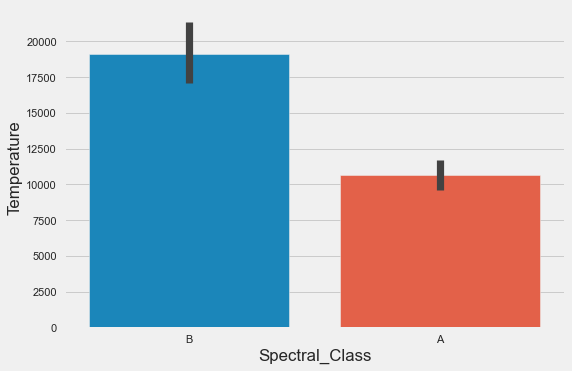

In [156]:
sns.barplot(x = 'Spectral_Class',y = 'Temperature',data = bluew_df)
plt.show()

In [157]:
fig = px.histogram(bluew_df, 'Temperature',             
                   color = 'Type')
fig.show()

In [158]:
fig = px.histogram(bluew_df, 'L',             
                   color = 'Type')
fig.show()

In [159]:
fig = px.histogram(bluew_df, 'L',             
                   color = 'Spectral_Class')
fig.show()

In [160]:
fig = px.histogram(bluew_df, 'R',             
                   color = 'Type')
fig.show()

In [161]:
fig = px.histogram(bluew_df, 'R',             
                   color = 'Spectral_Class')
fig.show()

In [162]:
fig = px.histogram(bluew_df, 'A_M',             
                   color = 'Type')
fig.show()

In [163]:
fig = px.histogram(bluew_df, 'A_M',             
                   color = 'Spectral_Class')
fig.show()

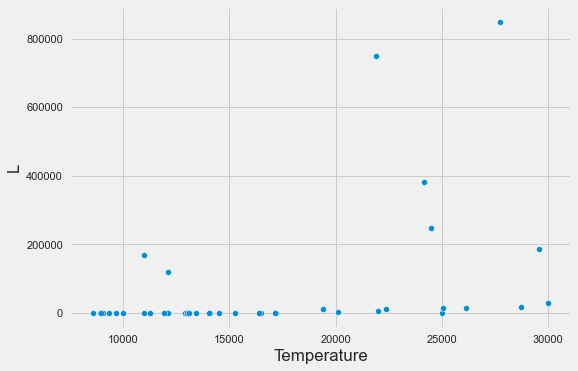

In [164]:
sns.scatterplot(x = 'Temperature',y = 'L',data = bluew_df)
plt.show()

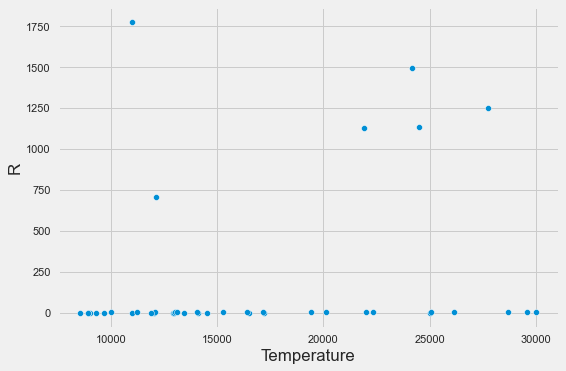

In [165]:
sns.scatterplot(x = 'Temperature',y = 'R',data = bluew_df)
plt.show()

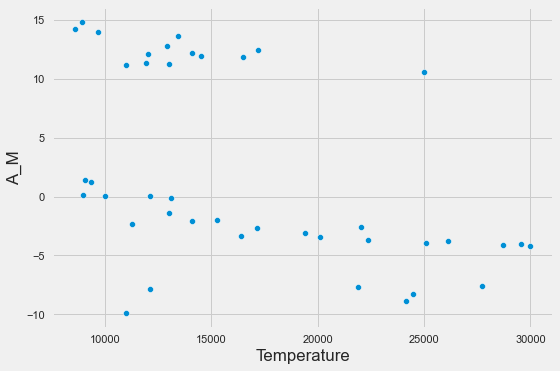

In [166]:
sns.scatterplot(x = 'Temperature',y = 'A_M',data = bluew_df)
plt.show()

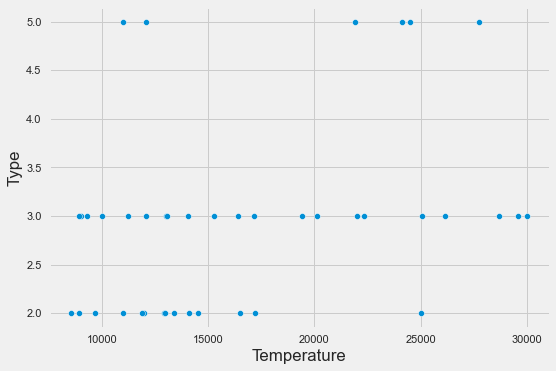

In [167]:
sns.scatterplot(x = 'Temperature',y = 'Type',data = bluew_df)
plt.show()

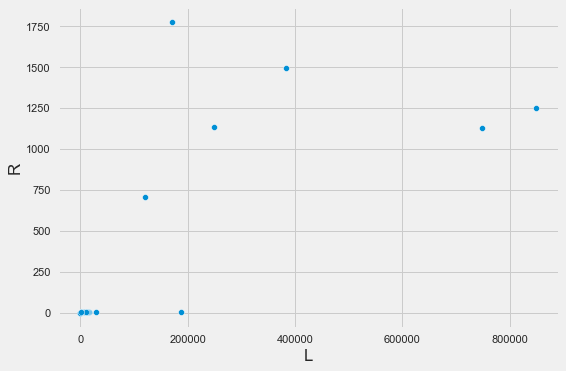

In [168]:
sns.scatterplot(x = 'L',y = 'R',data = bluew_df)
plt.show()

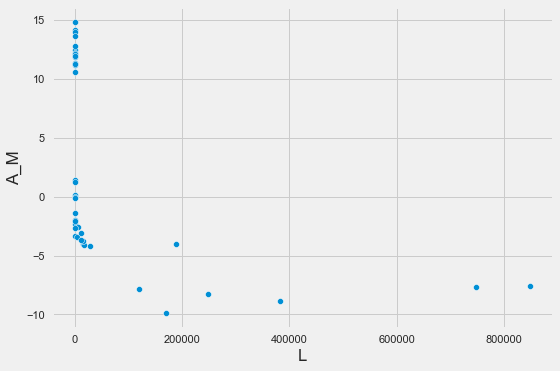

In [169]:
sns.scatterplot(x = 'L',y = 'A_M',data = bluew_df)
plt.show()

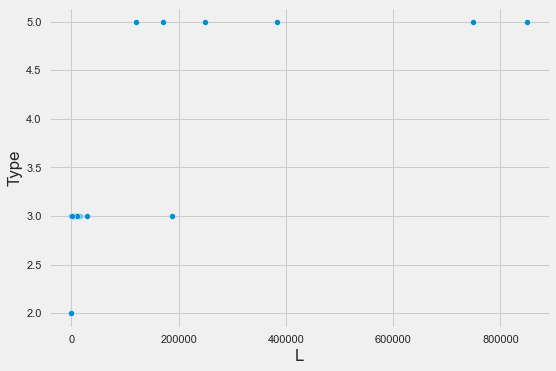

In [170]:
sns.scatterplot(x = 'L',y = 'Type',data = bluew_df)
plt.show()

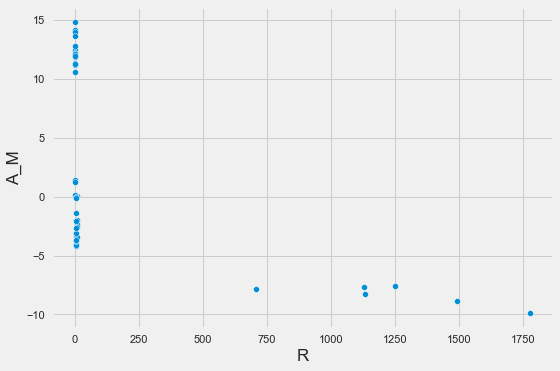

In [171]:
sns.scatterplot(x = 'R',y = 'A_M',data = bluew_df)
plt.show()

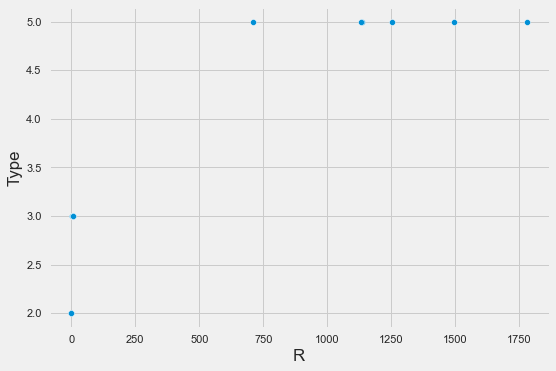

In [172]:
sns.scatterplot(x = 'R',y = 'Type',data =bluew_df)
plt.show()

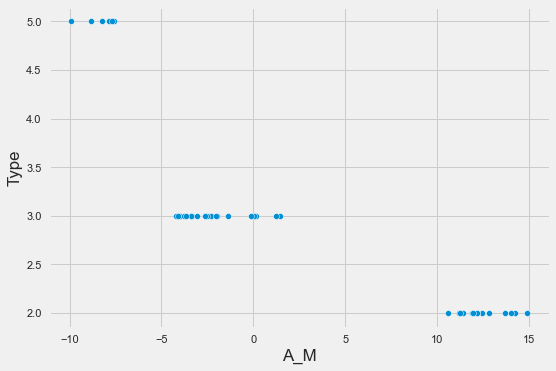

In [173]:
sns.scatterplot(x = 'A_M',y = 'Type',data = bluew_df)
plt.show()

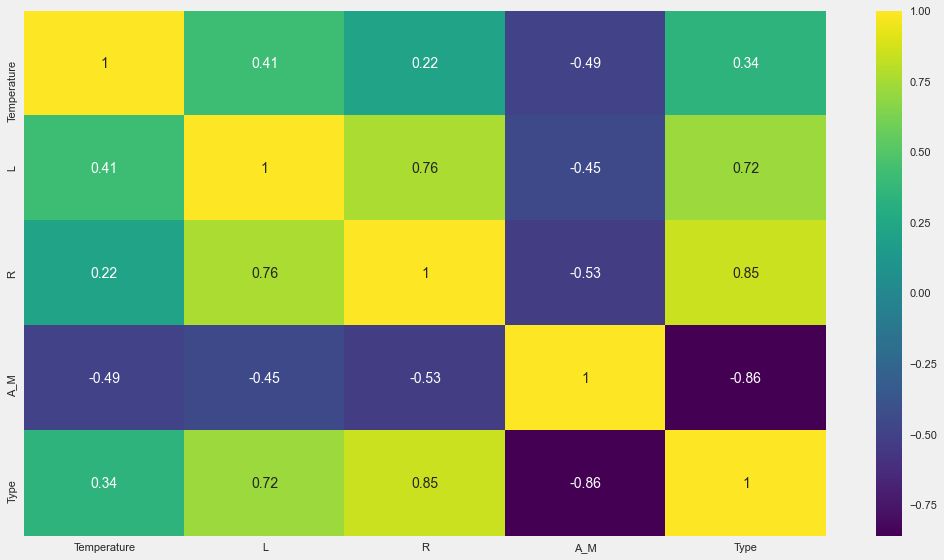

In [174]:
plt.figure(figsize=(16,9))
x = bluew_df.drop(['Color','Spectral_Class'],axis = 1)
ax = sns.heatmap(x.corr(),annot = True,cmap = 'viridis')
plt.show()

In [175]:
t = bluew_df[bluew_df['Spectral_Class'] == 'A']
t

,Temperature,L,R,A_M,Color,Spectral_Class,Type
26,8570,0.00081,0.00970,14.200,Blue-white,A,2
85,9675,0.00045,0.01090,13.980,Blue-white,A,2
94,9030,45.00000,2.63000,1.450,Blue-white,A,3
95,11250,672.00000,6.98000,-2.300,Blue-white,A,3
98,12098,689.00000,7.01000,0.020,Blue-white,A,3
145,8924,0.00028,0.00879,14.870,Blue-white,A,2
151,8945,38.00000,2.48700,0.120,Blue-white,A,3
152,14060,1092.00000,5.74500,-2.040,Blue-white,A,3
158,13023,998.00000,6.21000,-1.380,Blue-white,A,3
211,10012,552.00000,5.85600,0.013,Blue-white,A,3


In [176]:
bluew_df[bluew_df['Spectral_Class'] == 'A']['Type'].value_counts()

3    9
2    3
Name: Type, dtype: int64

<AxesSubplot:xlabel='Type', ylabel='count'>

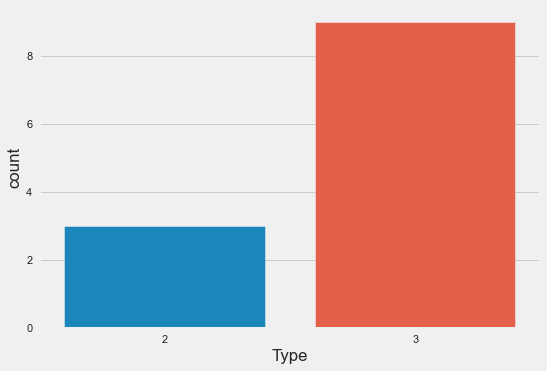

In [177]:
sns.countplot(x = 'Type',data = t)

In [178]:
fig = px.histogram(t, 'Temperature',             
                   color = 'Type')
fig.show()

In [179]:
fig = px.histogram(t, 'L',             
                   color = 'Type')
fig.show()

In [180]:
fig = px.histogram(t, 'R',             
                   color = 'Type')
fig.show()

In [181]:
fig = px.histogram(t, 'A_M',             
                   color = 'Type')
fig.show()

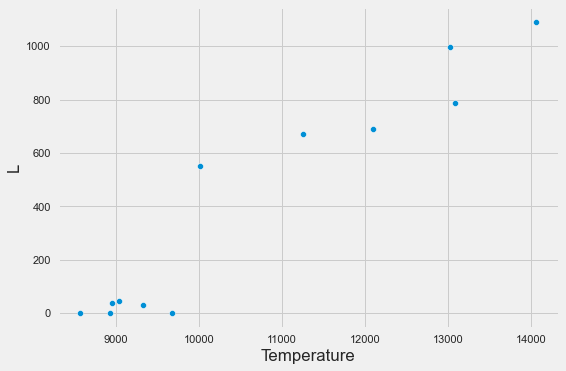

In [182]:
sns.scatterplot(x = 'Temperature',y = 'L',data = t)
plt.show()

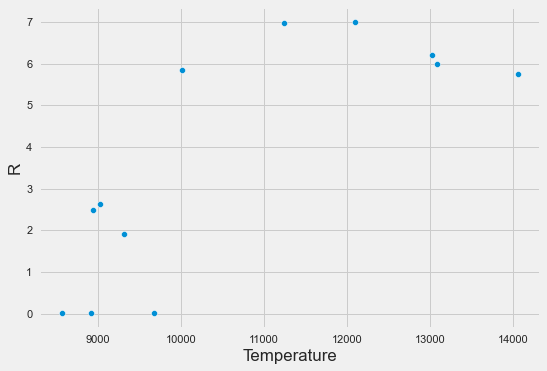

In [183]:
sns.scatterplot(x = 'Temperature',y = 'R',data = t)
plt.show()

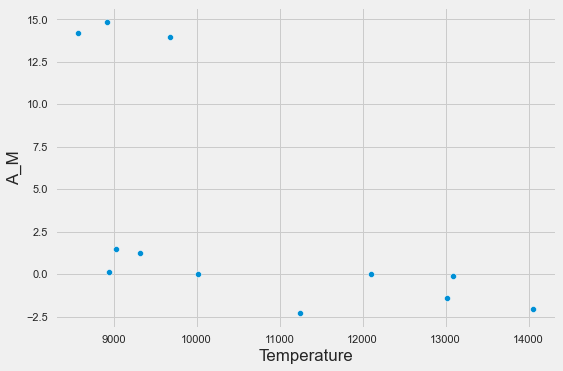

In [184]:
sns.scatterplot(x = 'Temperature',y = 'A_M',data = t)
plt.show()

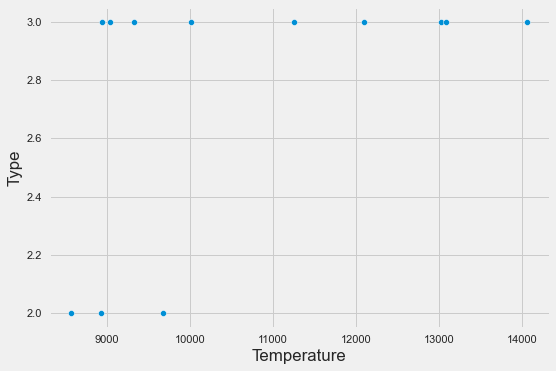

In [185]:
sns.scatterplot(x = 'Temperature',y = 'Type',data = t)
plt.show()

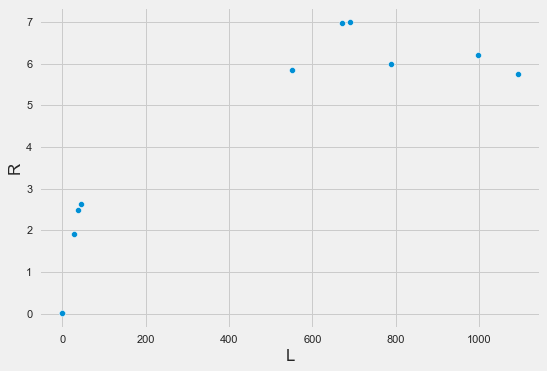

In [186]:
sns.scatterplot(x = 'L',y = 'R',data = t)
plt.show()

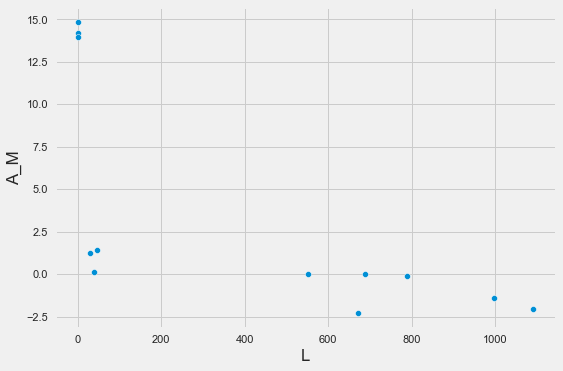

In [187]:
sns.scatterplot(x = 'L',y = 'A_M',data = t)
plt.show()

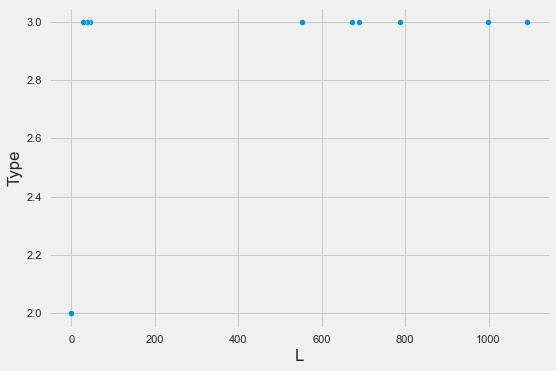

In [188]:
sns.scatterplot(x = 'L',y = 'Type',data = t)
plt.show()

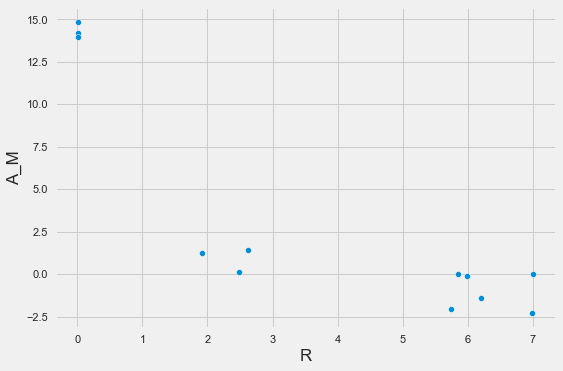

In [189]:
sns.scatterplot(x = 'R',y = 'A_M',data = t)
plt.show()

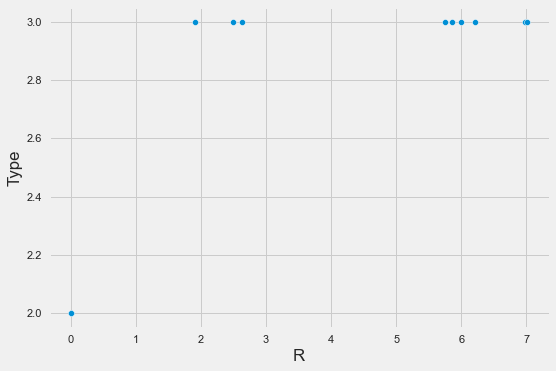

In [190]:
sns.scatterplot(x = 'R',y = 'Type',data = t)
plt.show()

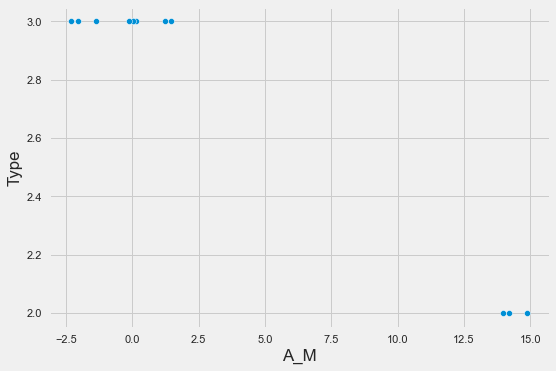

In [191]:
sns.scatterplot(x = 'A_M',y = 'Type',data = t)
plt.show()

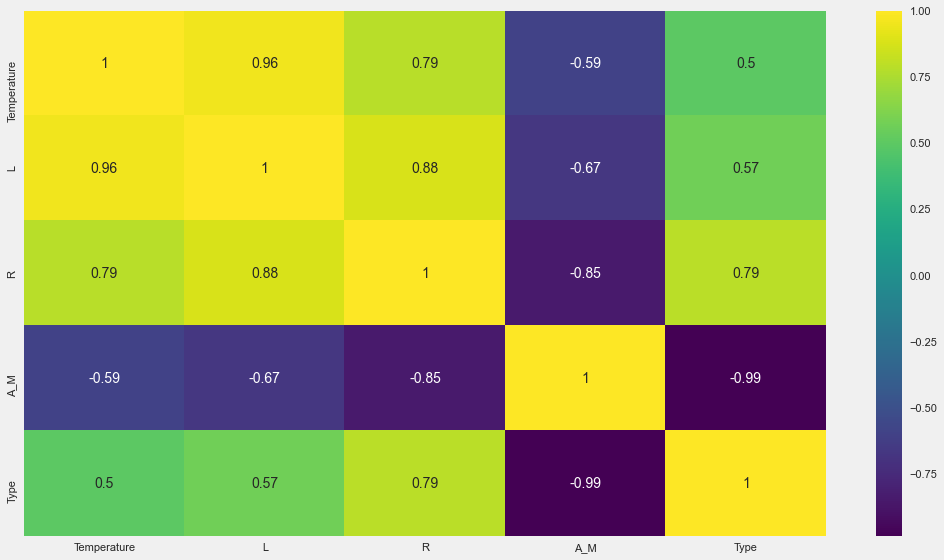

In [192]:
plt.figure(figsize=(16,9))
x = t.drop(['Color','Spectral_Class'],axis = 1)
ax = sns.heatmap(x.corr(),annot = True,cmap = 'viridis')
plt.show()

In [193]:
q = bluew_df[bluew_df['Spectral_Class'] == 'B']
q

,Temperature,L,R,A_M,Color,Spectral_Class,Type
20,25000,0.05600,0.00840,10.58,Blue-white,B,2
24,16500,0.01300,0.01400,11.89,Blue-white,B,2
31,30000,28840.00000,6.30000,-4.20,Blue-white,B,3
32,15276,1136.00000,7.20000,-1.97,Blue-white,B,3
83,17200,0.00098,0.01500,12.45,Blue-white,B,2
84,14100,0.00067,0.00890,12.17,Blue-white,B,2
86,12010,0.00078,0.00920,12.13,Blue-white,B,2
87,10980,0.00074,0.00870,11.19,Blue-white,B,2
140,13420,0.00059,0.00981,13.67,Blue-white,B,2
143,14520,0.00082,0.00972,11.92,Blue-white,B,2


In [194]:
bluew_df[bluew_df['Spectral_Class'] == 'B']['Type'].value_counts()

3    12
2    11
5     6
Name: Type, dtype: int64

<AxesSubplot:xlabel='Type', ylabel='count'>

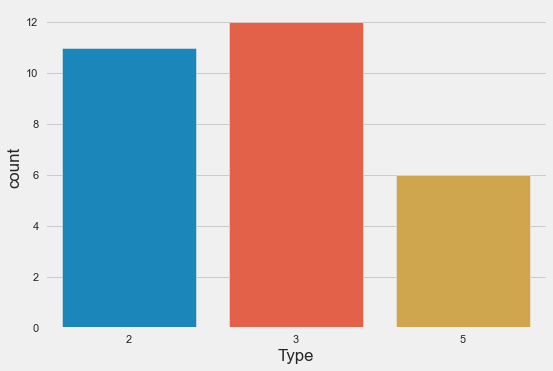

In [195]:
sns.countplot(x = 'Type',data = q)

In [196]:
fig = px.histogram(q, 'Temperature',             
                   color = 'Type')
fig.show()

In [197]:
fig = px.histogram(q, 'L',             
                   color = 'Type')
fig.show()

In [198]:
fig = px.histogram(q, 'R',             
                   color = 'Type')
fig.show()

In [199]:
fig = px.histogram(q, 'A_M',             
                   color = 'Type')
fig.show()

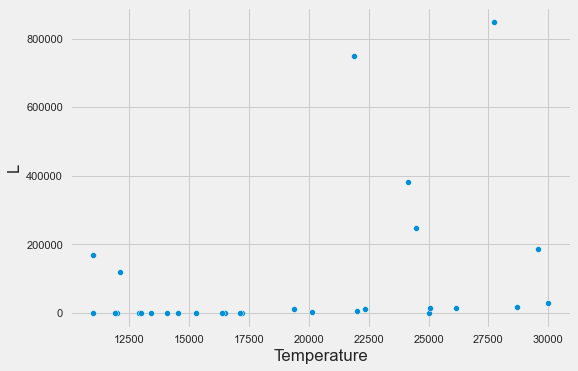

In [200]:
sns.scatterplot(x = 'Temperature',y = 'L',data = q)
plt.show()

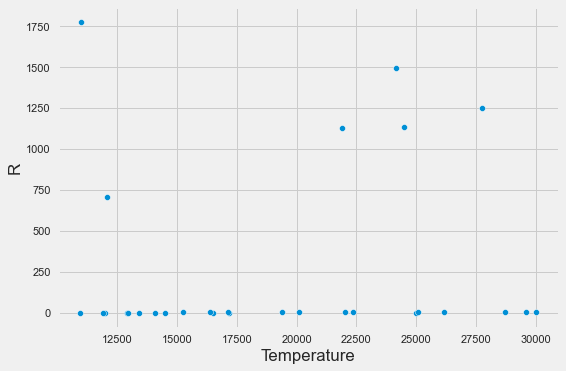

In [201]:
sns.scatterplot(x = 'Temperature',y = 'R',data = q)
plt.show()

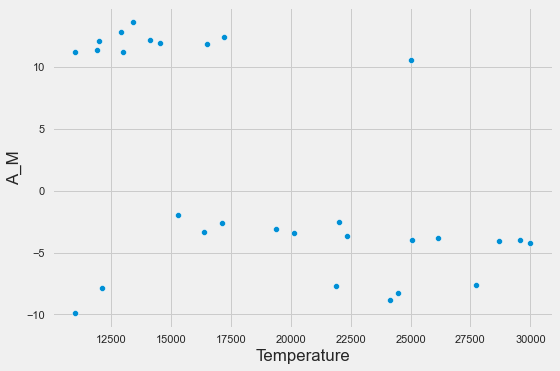

In [202]:
sns.scatterplot(x = 'Temperature',y = 'A_M',data = q)
plt.show()

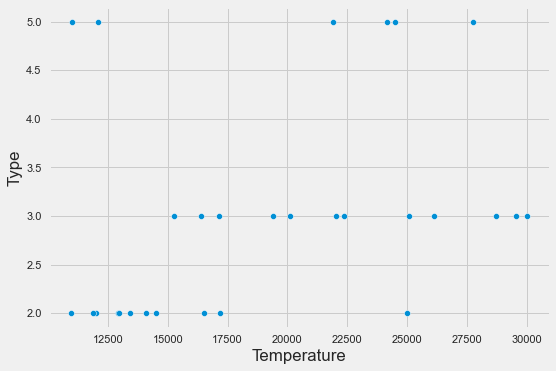

In [203]:
sns.scatterplot(x = 'Temperature',y = 'Type',data = q)
plt.show()

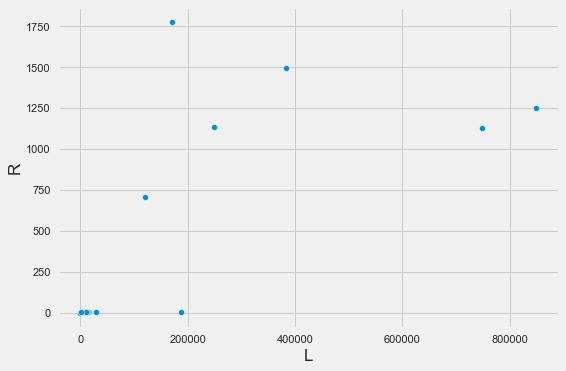

In [204]:
sns.scatterplot(x = 'L',y = 'R',data = q)
plt.show()

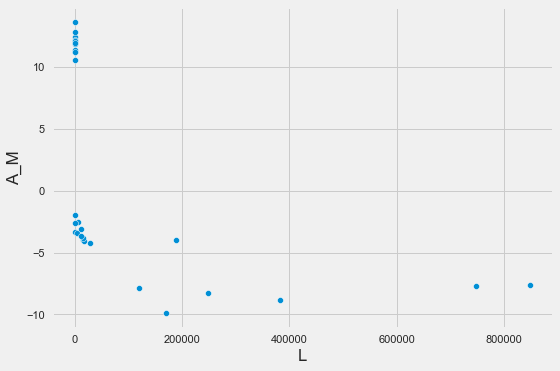

In [205]:
sns.scatterplot(x = 'L',y = 'A_M',data = q)
plt.show()

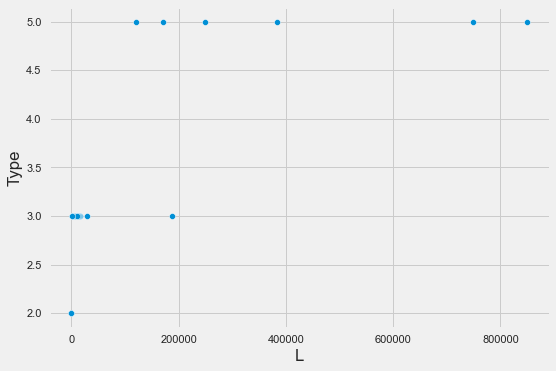

In [206]:
sns.scatterplot(x = 'L',y = 'Type',data = q)
plt.show()

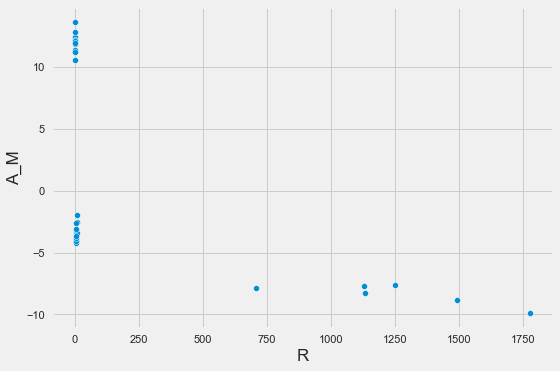

In [207]:
sns.scatterplot(x = 'R',y = 'A_M',data = q)
plt.show()

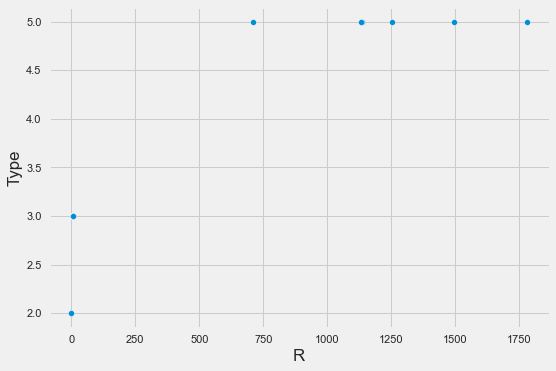

In [208]:
sns.scatterplot(x = 'R',y = 'Type',data = q)
plt.show()

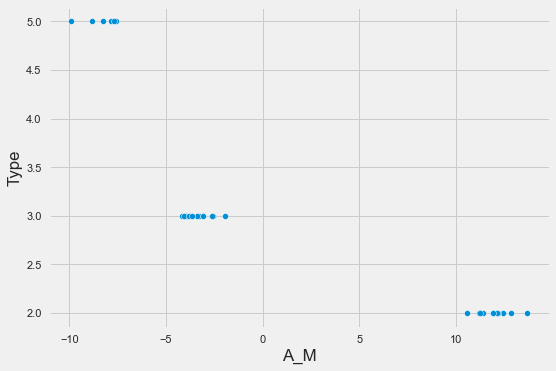

In [209]:
sns.scatterplot(x = 'A_M',y = 'Type',data = q)
plt.show()

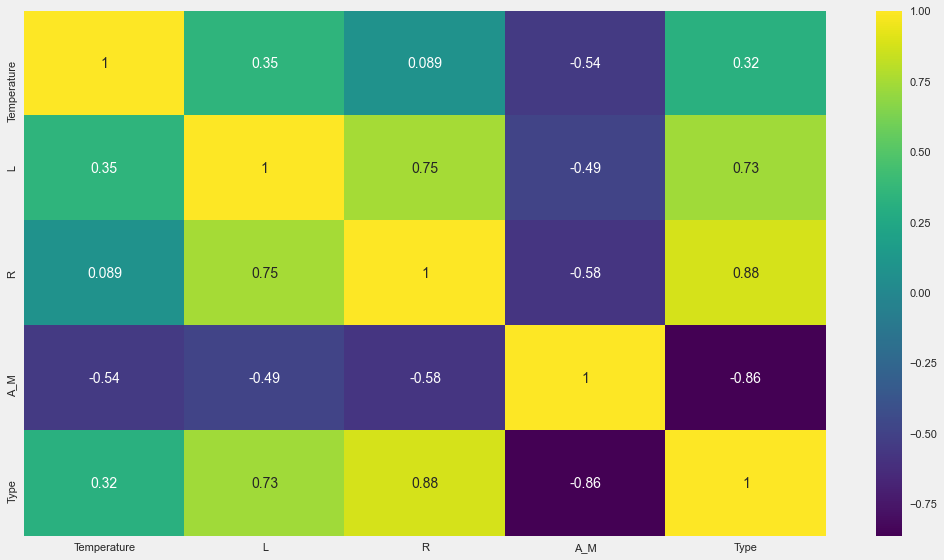

In [210]:
plt.figure(figsize=(16,9))
x = q.drop(['Color','Spectral_Class'],axis = 1)
ax = sns.heatmap(q.corr(),annot = True,cmap = 'viridis')
plt.show()

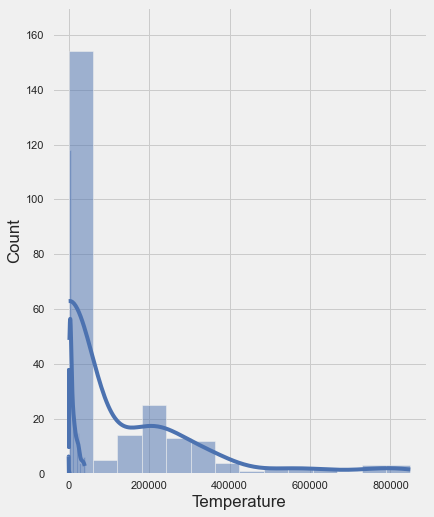

In [211]:
plt.figure(figsize=(6,8))
x = df.drop(['Color','Spectral_Class'],axis = 1)
for i in x.columns:
    sns.histplot(x[i],kde = True)
    plt.show()

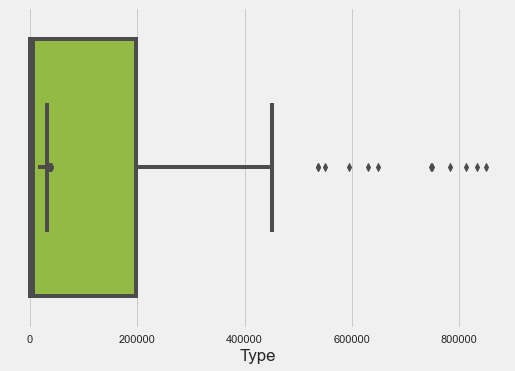

In [212]:
x = df.drop(['Color','Spectral_Class'],axis = 1)
for i in x.columns:
    sns.boxplot(x = i, data = x,color = 'yellowgreen')   
    plt.xlabel(i)
    plt.show()

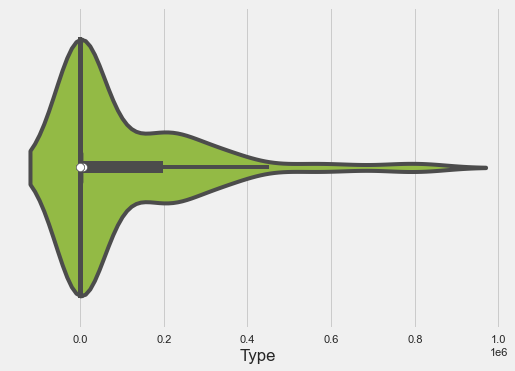

In [213]:
x = df.drop(['Color','Spectral_Class'],axis = 1)
for i in x.columns:
    sns.violinplot(x = i, data = x,color = 'yellowgreen')   
    plt.xlabel(i)
    plt.show()

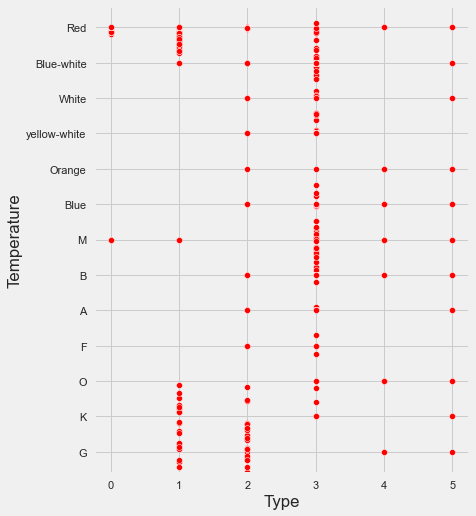

In [214]:
plt.figure(figsize=(6,8))
for i in df.columns:
    sns.scatterplot(x = 'Type',y = i,data = df,color = 'Red')
    plt.show()

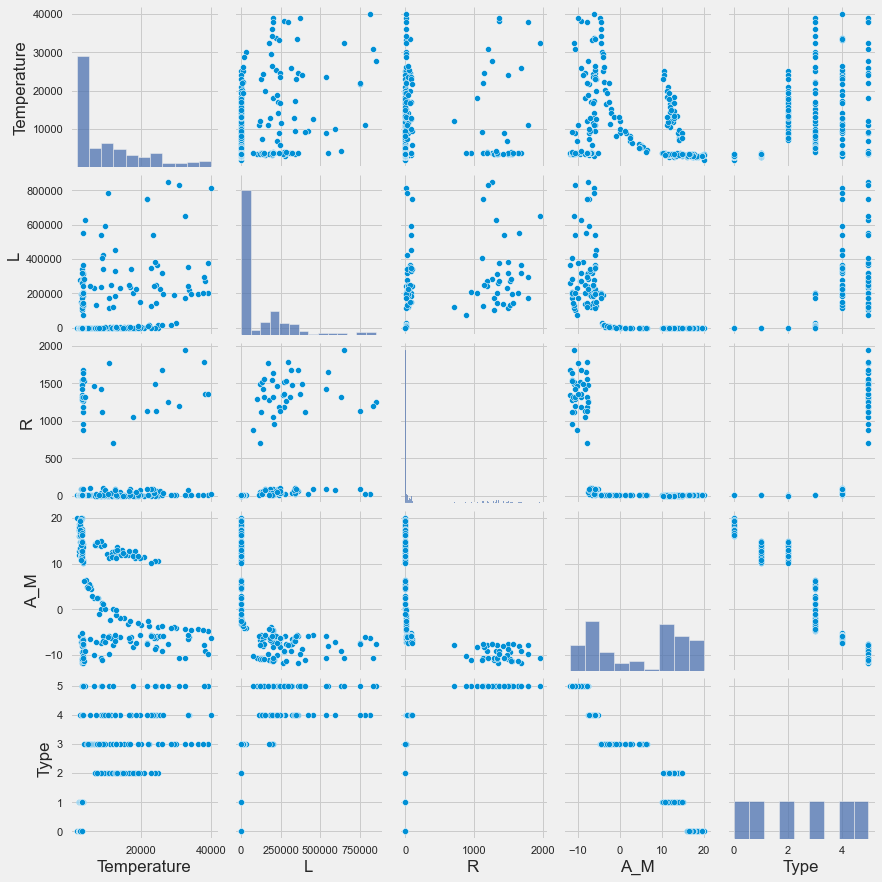

In [215]:
sns.pairplot(df)

# Count of outliers

In [216]:
def count_outliers(data,col):
        q1 = data[col].quantile(0.25,interpolation='nearest')
        q2 = data[col].quantile(0.5,interpolation='nearest')
        q3 = data[col].quantile(0.75,interpolation='nearest')
        q4 = data[col].quantile(1,interpolation='nearest')
        IQR = q3 -q1
        global LLP
        global ULP
        LLP = q1 - 1.5*IQR
        ULP = q3 + 1.5*IQR
        if data[col].min() > LLP and data[col].max() < ULP:
            print("No outliers in",i)
        else:
            print("There are outliers in",i)
            x = data[data[col]<LLP][col].size
            y = data[data[col]>ULP][col].size
            a.append(i)
            print('Count of outliers are:',x+y)
global a
a = []
for i in x.columns:
    count_outliers(df,i)

There are outliers in Temperature
Count of outliers are: 13
There are outliers in L
Count of outliers are: 12
There are outliers in R
Count of outliers are: 40
No outliers in A_M
No outliers in Type


# Encoding

In [217]:
df1=pd.get_dummies(data=df,columns=["Color","Spectral_Class"],drop_first=True)

In [218]:
df1

,Temperature,L,R,A_M,Type,Color_Blue-white,Color_Orange,Color_Red,Color_White,Color_yellow-white,Spectral_Class_B,Spectral_Class_F,Spectral_Class_G,Spectral_Class_K,Spectral_Class_M,Spectral_Class_O
0,3068,0.002400,0.1700,16.12,0,0,0,1,0,0,0,0,0,0,1,0
1,3042,0.000500,0.1542,16.60,0,0,0,1,0,0,0,0,0,0,1,0
2,2600,0.000300,0.1020,18.70,0,0,0,1,0,0,0,0,0,0,1,0
3,2800,0.000200,0.1600,16.65,0,0,0,1,0,0,0,0,0,0,1,0
4,1939,0.000138,0.1030,20.06,0,0,0,1,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,38940,374830.000000,1356.0000,-9.93,5,0,0,0,0,0,0,0,0,0,0,1
236,30839,834042.000000,1194.0000,-10.63,5,0,0,0,0,0,0,0,0,0,0,1
237,8829,537493.000000,1423.0000,-10.73,5,0,0,0,1,0,0,0,0,0,0,0
238,9235,404940.000000,1112.0000,-11.23,5,0,0,0,1,0,0,0,0,0,0,0


## Reaaranging Columns

In [219]:
df1 = df1[['Temperature', 'L', 'R', 'A_M', 'Color_Blue-white',
       'Color_Orange', 'Color_Red', 'Color_White', 'Color_yellow-white',
       'Spectral_Class_B', 'Spectral_Class_F', 'Spectral_Class_G',
       'Spectral_Class_K', 'Spectral_Class_M', 'Spectral_Class_O', 'Type']]

In [220]:
df1

,Temperature,L,R,A_M,Color_Blue-white,Color_Orange,Color_Red,Color_White,Color_yellow-white,Spectral_Class_B,Spectral_Class_F,Spectral_Class_G,Spectral_Class_K,Spectral_Class_M,Spectral_Class_O,Type
0,3068,0.002400,0.1700,16.12,0,0,1,0,0,0,0,0,0,1,0,0
1,3042,0.000500,0.1542,16.60,0,0,1,0,0,0,0,0,0,1,0,0
2,2600,0.000300,0.1020,18.70,0,0,1,0,0,0,0,0,0,1,0,0
3,2800,0.000200,0.1600,16.65,0,0,1,0,0,0,0,0,0,1,0,0
4,1939,0.000138,0.1030,20.06,0,0,1,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,38940,374830.000000,1356.0000,-9.93,0,0,0,0,0,0,0,0,0,0,1,5
236,30839,834042.000000,1194.0000,-10.63,0,0,0,0,0,0,0,0,0,0,1,5
237,8829,537493.000000,1423.0000,-10.73,0,0,0,1,0,0,0,0,0,0,0,5
238,9235,404940.000000,1112.0000,-11.23,0,0,0,1,0,0,0,0,0,0,0,5


# Feature Scaling

In [223]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

In [224]:
scaler.fit(df1.drop('Type',axis = 1))

StandardScaler()

In [225]:
scaled_features = scaler.transform(df1.drop('Type',axis = 1))

# Feature Selection

In [226]:
df_feat = pd.DataFrame(scaled_features,columns = df1.columns[:-1])
df_feat.head()

,Temperature,L,R,A_M,Color_Blue-white,Color_Orange,Color_Red,Color_White,Color_yellow-white,Spectral_Class_B,Spectral_Class_F,Spectral_Class_G,Spectral_Class_K,Spectral_Class_M,Spectral_Class_O
0,-0.779382,-0.598624,-0.459210,1.116745,-0.453905,-0.130189,1.069045,-0.229416,-0.258199,-0.486943,-0.276104,-0.064685,-0.160128,1.078036,-0.447214
1,-0.782110,-0.598624,-0.459241,1.162414,-0.453905,-0.130189,1.069045,-0.229416,-0.258199,-0.486943,-0.276104,-0.064685,-0.160128,1.078036,-0.447214
2,-0.828477,-0.598624,-0.459342,1.362213,-0.453905,-0.130189,1.069045,-0.229416,-0.258199,-0.486943,-0.276104,-0.064685,-0.160128,1.078036,-0.447214
3,-0.807496,-0.598624,-0.459229,1.167171,-0.453905,-0.130189,1.069045,-0.229416,-0.258199,-0.486943,-0.276104,-0.064685,-0.160128,1.078036,-0.447214
4,-0.897819,-0.598624,-0.459340,1.491607,-0.453905,-0.130189,1.069045,-0.229416,-0.258199,-0.486943,-0.276104,-0.064685,-0.160128,1.078036,-0.447214


In [229]:
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
X = df_feat
y = df1['Type']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)
knn = KNeighborsClassifier(n_neighbors = 1)
knn.fit(X_train,y_train)

KNeighborsClassifier(n_neighbors=1)

In [230]:
pred = knn.predict(X_test)
pred

array([2, 3, 0, 3, 0, 4, 4, 3, 0, 0, 5, 3, 5, 3, 3, 1, 1, 5, 3, 2, 2, 0,
       5, 3, 0, 5, 5, 2, 3, 2, 5, 1, 3, 2, 1, 3, 3, 2, 3, 0, 3, 3, 0, 0,
       2, 4, 1, 1, 2, 0, 2, 4, 2, 4, 2, 2, 5, 1, 5, 2, 5, 5, 0, 2, 1, 0,
       5, 5, 0, 3, 4, 5], dtype=int64)

In [232]:
from sklearn.metrics import classification_report,confusion_matrix

print(confusion_matrix(y_test,pred))

[[13  0  0  0  0  0]
 [ 0  8  0  0  0  0]
 [ 0  0 12  0  0  0]
 [ 0  0  3 14  0  0]
 [ 0  0  0  1  6  0]
 [ 0  0  0  1  0 14]]


In [233]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        13
           1       1.00      1.00      1.00         8
           2       0.80      1.00      0.89        12
           3       0.88      0.82      0.85        17
           4       1.00      0.86      0.92         7
           5       1.00      0.93      0.97        15

    accuracy                           0.93        72
   macro avg       0.95      0.94      0.94        72
weighted avg       0.94      0.93      0.93        72



#  finding least value for K to apply KNN

In [234]:
error_rate= []
for i in range(1,40):
    knn = KNeighborsClassifier(n_neighbors = i)
    knn.fit(X_train,y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

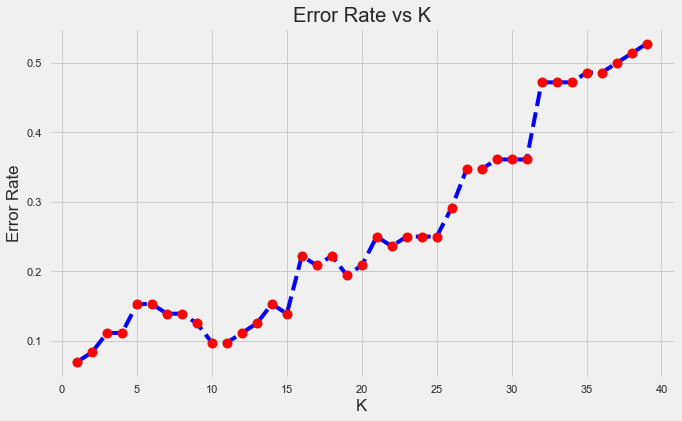

In [235]:
plt.figure(figsize = (10,6))
plt.plot(range(1,40),error_rate,color = 'blue',linestyle = '--',marker = 'o',markerfacecolor='red',markersize = 10)
plt.title('Error Rate vs K')
plt.xlabel('K')
plt.ylabel('Error Rate')


In [238]:

from sklearn import datasets, linear_model, metrics
print(metrics.accuracy_score(y_test, pred))

0.9305555555555556


# Thank you